In [1]:
from PIL import Image
import h5py
import anubisPlotUtils as anPlot
import json
import numpy as np
import os
import hist as hi
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.colors as colors
matplotlib.use('TkAgg')  # or 'Qt5Agg', 'GTK3Agg', etc.
import mplhep as hep
hep.style.use([hep.style.ATLAS])
import sys
import ANUBIS_triggered_functions as ANT
import pandas as pd
import matplotlib.backends.backend_pdf
from matplotlib.ticker import MultipleLocator
import plotly
import plotly.graph_objs as go
import plotly.express as px


%matplotlib inline

In [2]:
current_directory=  os.path.dirname(os.getcwd())

data = ANT.importDatafile(current_directory+"\\ProAnubisData\\ATLAS LUMINOSITY\\proAnubis_240403_0227.h5")

In [3]:
data_ATLAS = [sublist[:94230] for sublist in data]
etaHits, phiHits = ANT.divideHitCountsByRPC_Timed(data_ATLAS)

In [4]:
#Time_window for coincidence set at 15 ns.
#Temporal Clustering
coincident_hits_ATLAS = ANT.FindCoincidentHits(etaHits,phiHits,15)

#Spatial Clustering
coincident_hits_ATLAS_clustered = ANT.cluster(coincident_hits_ATLAS)

0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0

In [8]:
#Filter events depending on what you would like to look at.
#filter_events(data,minimum number of chambers hit, minimum number of RPCs hit)
cross_chamber_5_RPC_events = ANT.filter_events(coincident_hits_ATLAS_clustered,2,5)
print("......")

Number of events in filter = 6019
......


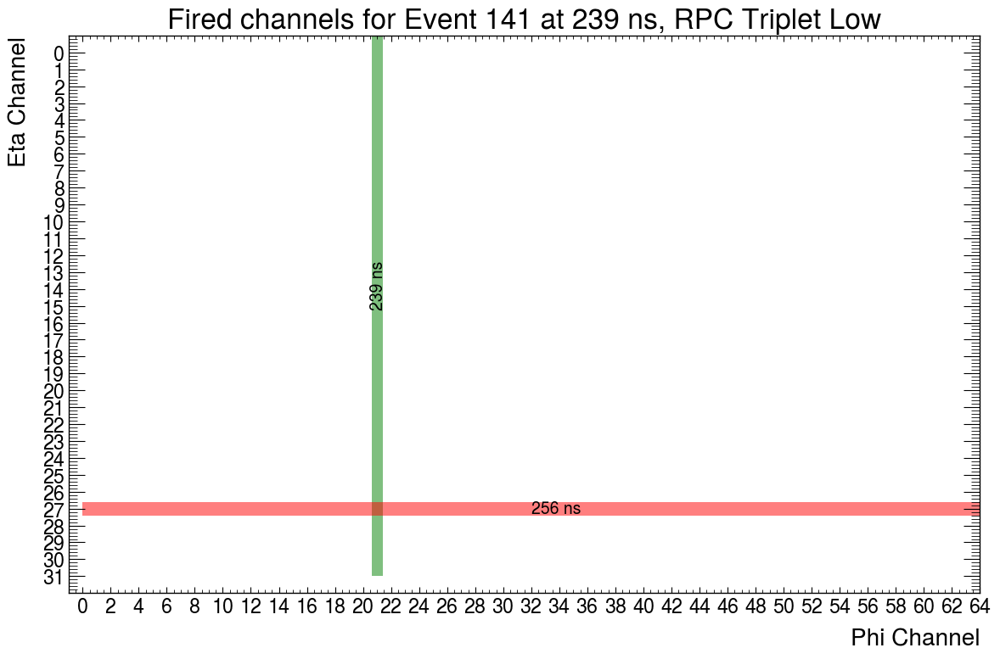

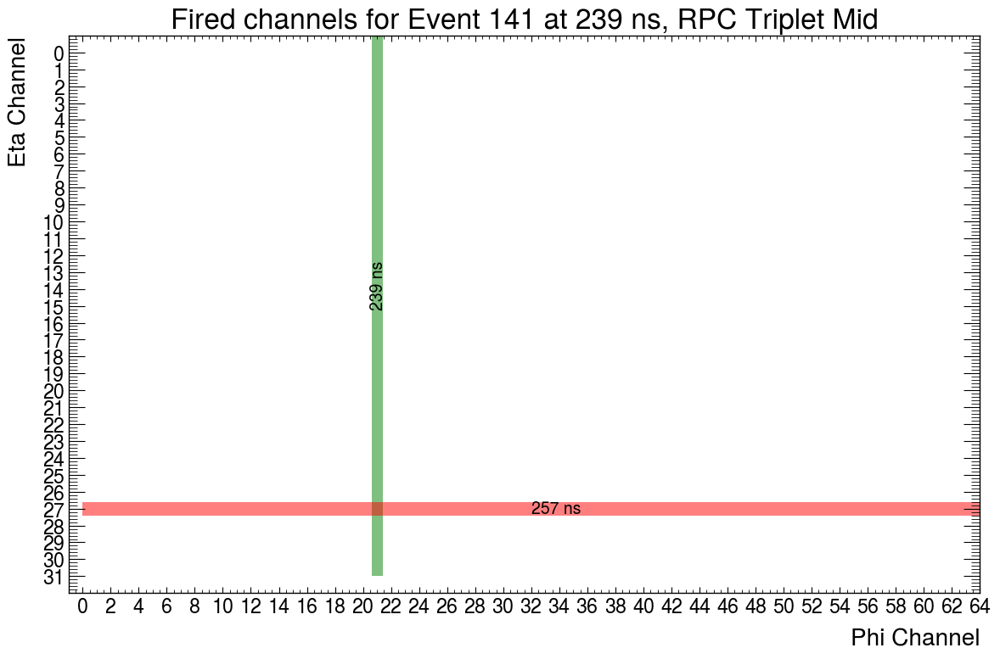

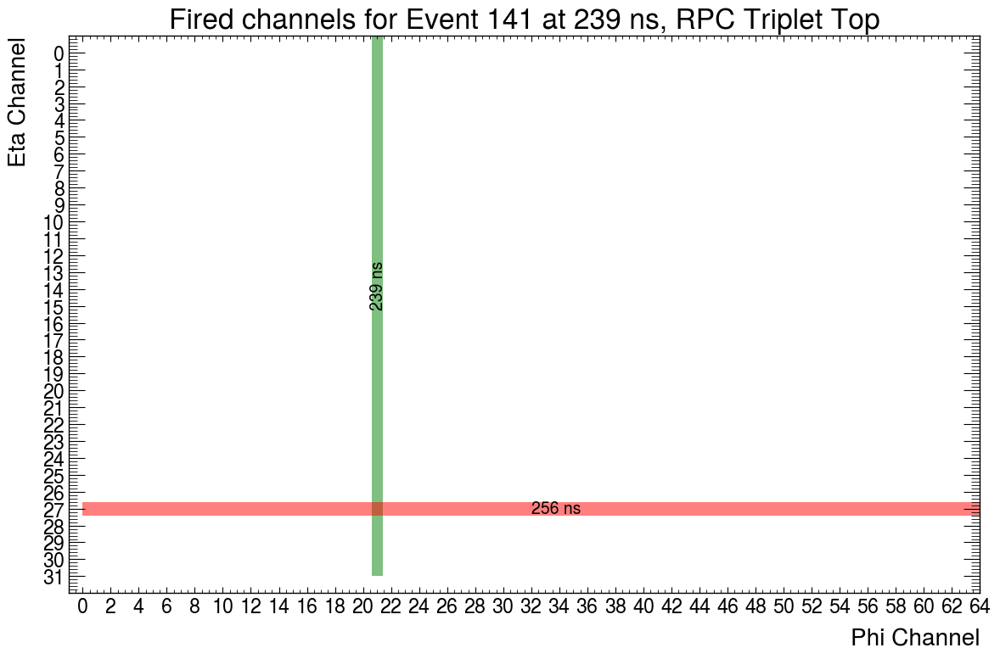

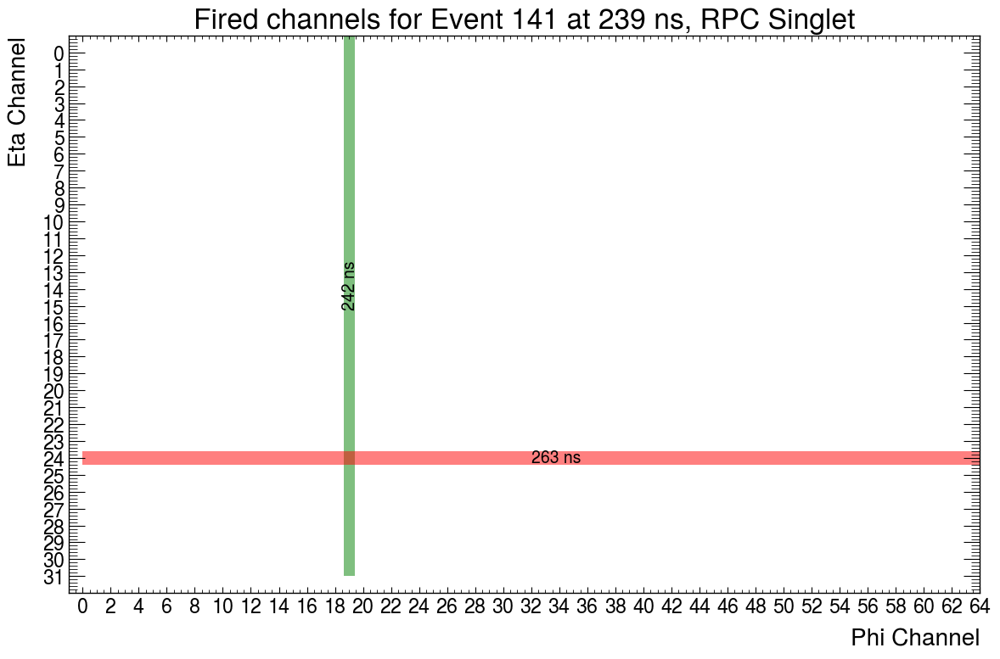

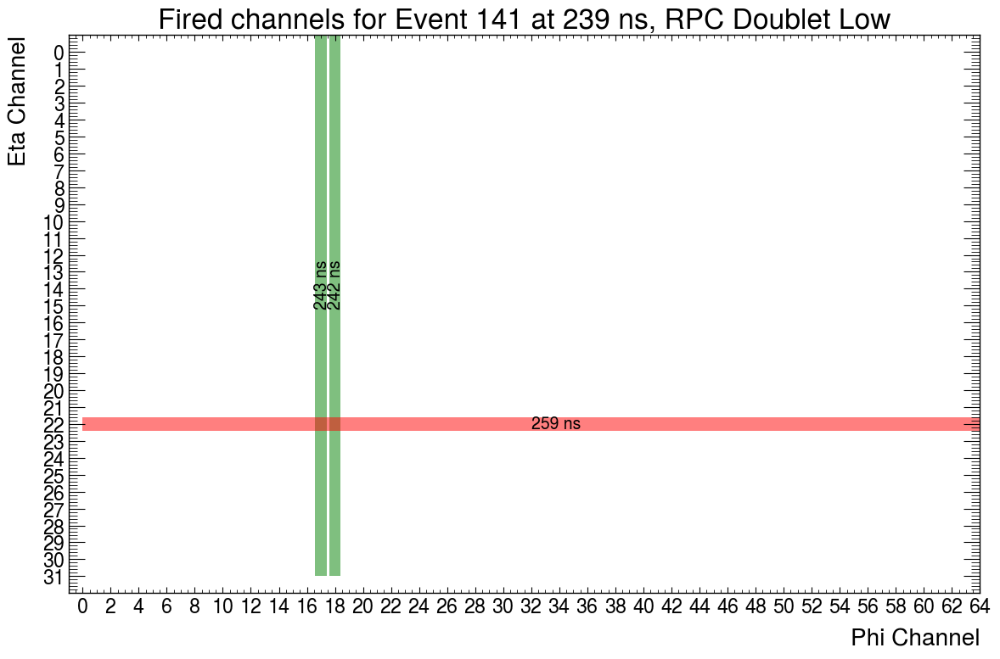

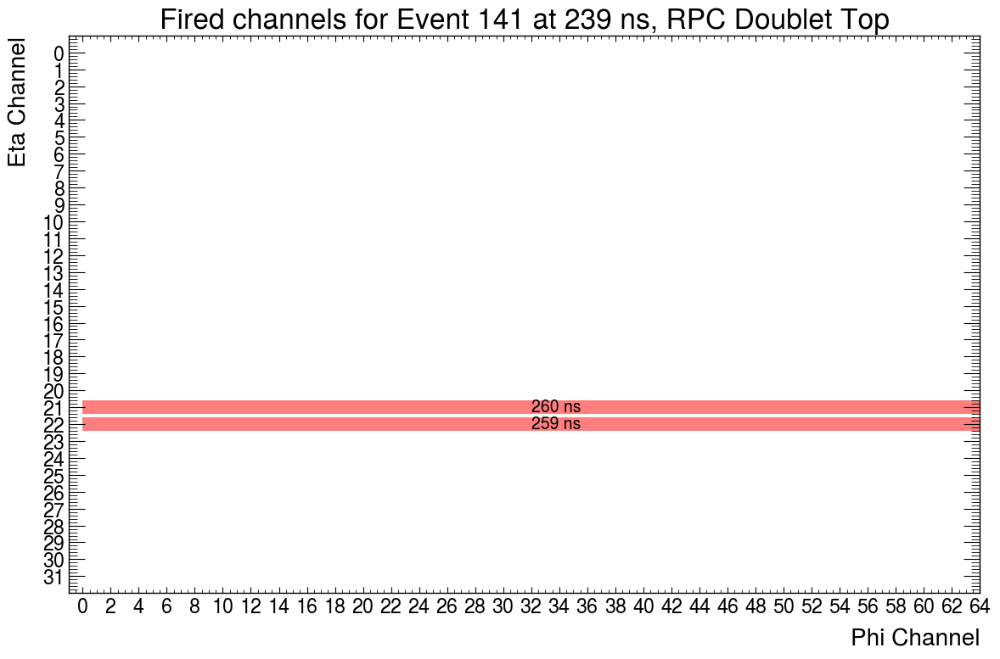

In [11]:
ANT.plot_event_cluster(ANT.convert_cluster_to_plot(cross_chamber_5_RPC_events[11]))

Changing filter functions. Now we can exclude an RPC from the filter. Also, since the data is triggered on the eta channels of the RPC, I am checking that atleast 4 other RPCs had eta hits. This will reduce the bias in the data due to it being triggered.

In [180]:
def check_event_attributes_by_RPC(event,min_chamber_number,min_RPC_number,RPC_excluded):
    #Used in filter_events() function to decide whether or not to save an event as described by the user's inputs.
    #The user selects an RPC to exclude from the filter. 
    #e.g. say we want to exclude RPC 4 and the user selects a min_RPC_number of 4. The check_event_...() will check if the
    #event has atleast 4 RPCs hit.

    #USING ONLY ETA FILTER HERE SINCE THIS IS WHAT TRIGGERS THE CHANNEL!

    # event = ['Event x',TIMEBIN, [[[RPC1_PHI_CLUSTERS],[RPC1_ETA_CLUSTERS]],[[...],[...]],...]

    RPC_counter = 0
    chamber_counter = 0
    condition_1 = False
    condition_2 = False
    condition_3 = False

    for RPC in range(6):

        if RPC ==  RPC_excluded:
            pass
        else:
            if RPC<3:
                #Checking triplet layer.
                if event[2][RPC][1]:
                    #Reqiure atleast one eta strip to go off
                    RPC_counter+=1 
                    #If RPC has two eta and phi strips going off then consider it "hit"
                    if not condition_1:
                        #Count triplet chamber being hit.
                        chamber_counter+=1
                        condition_1 = True
            elif RPC == 3:
                #Singlet layer
                if event[2][RPC][1]:
                    RPC_counter+=1
                    if not condition_2:
                        chamber_counter+=1
                        condition_2 = True
            else:
                #Doublet layer
                if event[2][RPC][1]:
                    RPC_counter+=1
                    if not condition_3:
                        chamber_counter+=1
                        condition_3 = True
    return RPC_counter >= min_RPC_number and chamber_counter >= min_chamber_number

In [18]:
check_event_attributes_by_RPC(cross_chamber_5_RPC_events[11],2,4,5)

5


True

In [26]:
def filter_events_by_RPC(events,min_chamber_number,min_RPC_number,RPC_excluded):
    #Initiliase array of filtered events
    filtered_events = []

    for event in events:
        if check_event_attributes_by_RPC(event,min_chamber_number,min_RPC_number,RPC_excluded):
            filtered_events.append(event)

    print(f"Number of events in filter = {len(filtered_events)}")
    
    return filtered_events

Now try the new filter. See if there are enough statistics. All filters have atleast 2 chambers hit, atleast 4 RPCs (other than one under test) hit.

In [27]:
exclude_one = filter_events_by_RPC(coincident_hits_ATLAS_clustered,2,4,1)

Number of events in filter = 11640


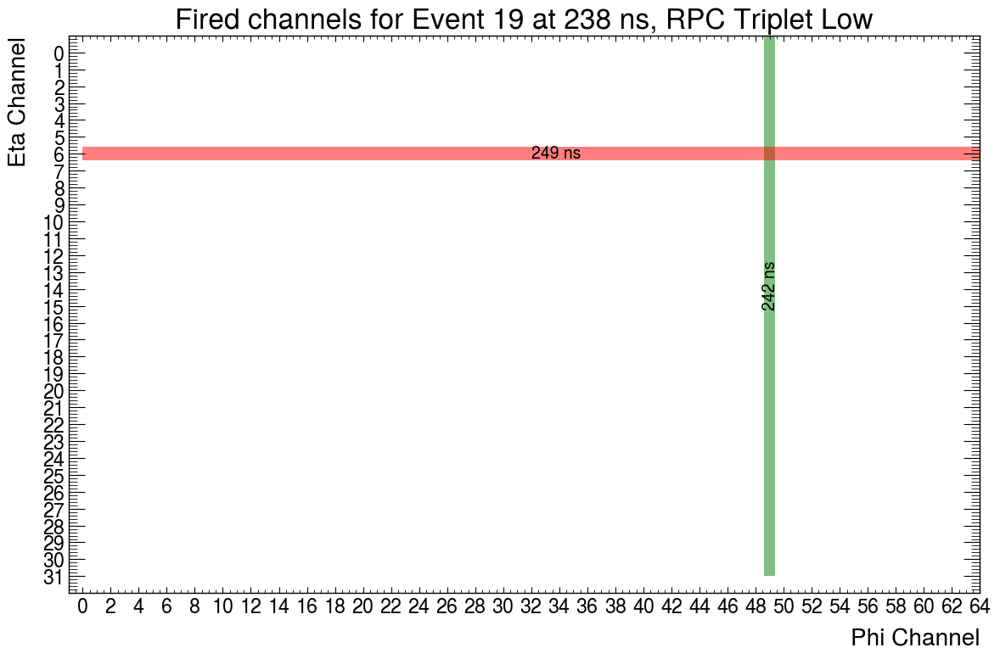

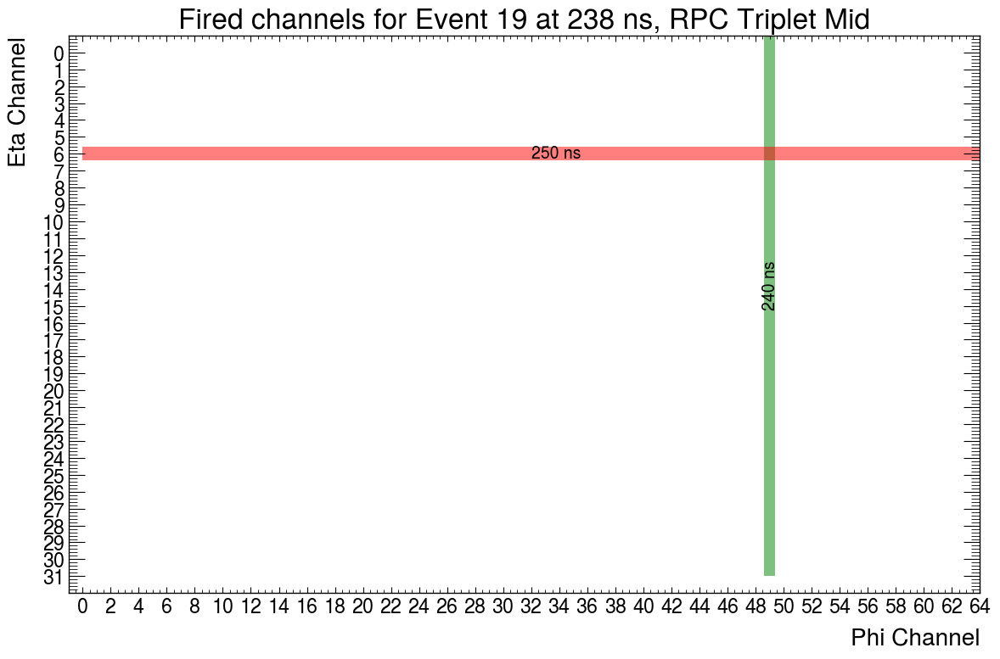

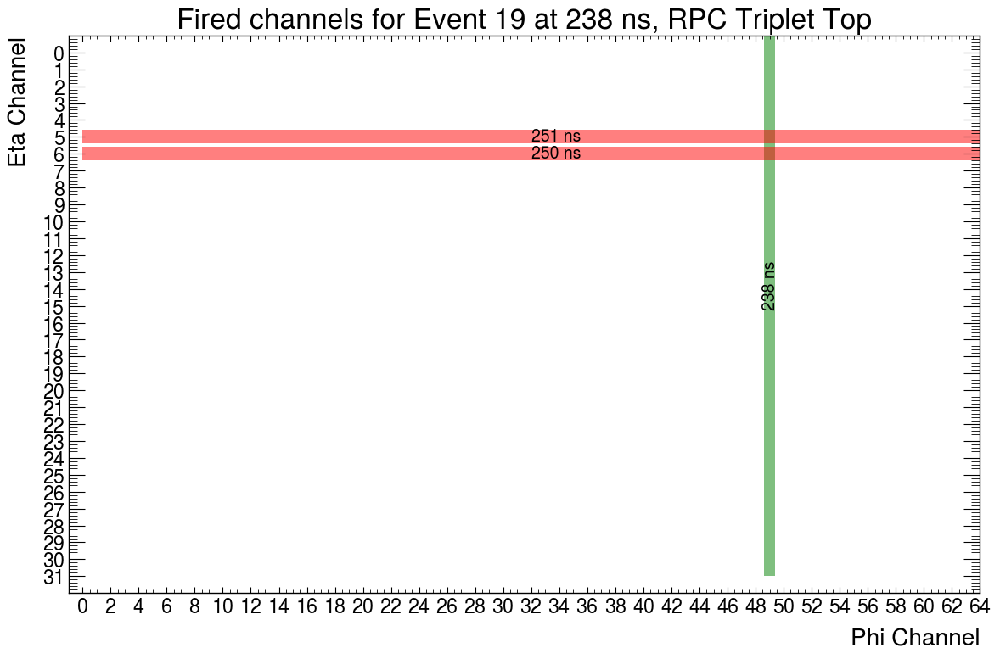

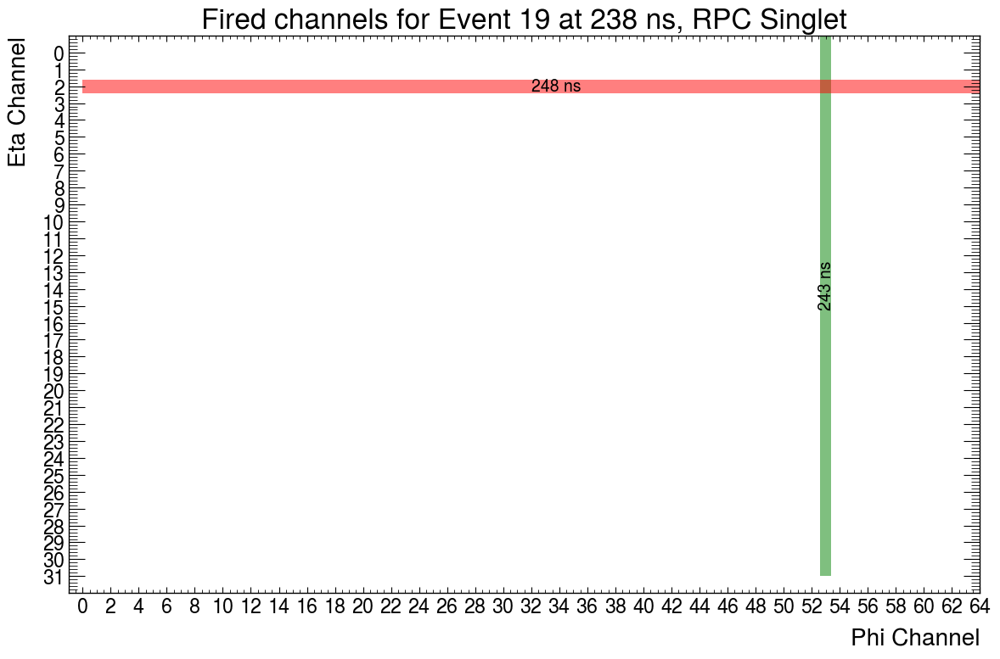

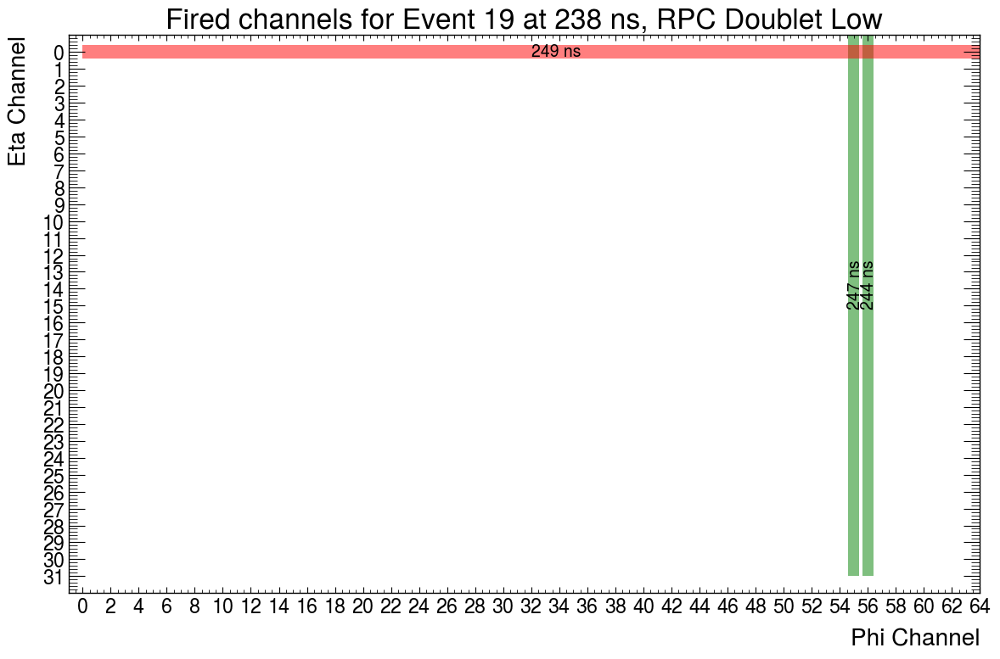

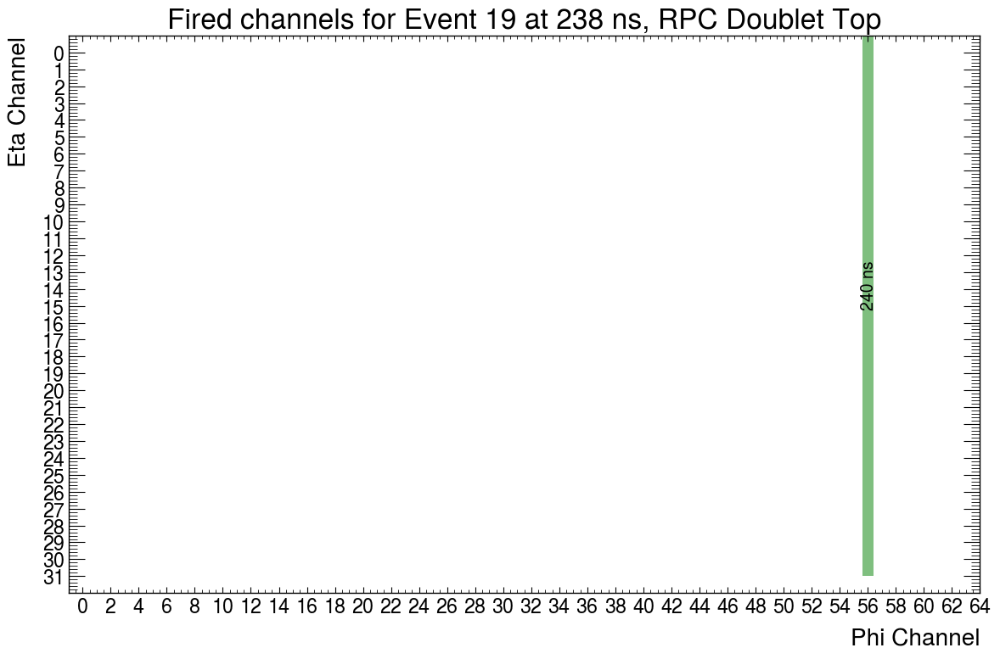

In [55]:
ANT.plot_event_cluster(ANT.convert_cluster_to_plot(exclude_one[0]))

Now, reconstruct the event without using the RPC under test. The coords of the RPC under test are stored separetly. 

Testing triplet mid currently

In [325]:
def reconstruct_timed_byRPC(event,max_cluster_size,RPC_excluded):

    #timed tag indicates that timing information from RPC is used to determine direction of vertical transversal of "particle" in the event.

    max_residual = 100

    # event = ['Event x',TIMEBIN, [[[RPC1_PHI_CLUSTERS],[RPC1_ETA_CLUSTERS]],[[...],[...]],...]
    RPC_heights = [0.6,1.8,3.0,61.8,121.8,123] #Heights of middle point of each RPC, measured from the bottom of the Triplet Low RPC. Units are cm.

    #Extract x and y coords of cluster in event

    coords = ANT.extract_coords_timed(event,max_cluster_size)

    print(coords)

    #UPDATE COORDS TO IGNORE THE RPC UNDER TEST

    test_coords = coords[RPC_excluded]
    coords[RPC_excluded] = [[],[],"N"]

    dT = ANT.extract_DT(coords)

    #print(coords)

    if dT is None:
        print("Failed to reconstruct, dT is NoneType")
        return None

    # Count the number of empty RPCs
    empty_RPC_count = sum(1 for item in coords if item == [[], [],'N'])

    # If less than 3 elements of coords are occupied, exit the function
    if empty_RPC_count > 3:
        print("Failed to reconstruct, not enough coords")
        return None  # Exit the function

    #ITERATING OVER EVERY POSSIBLE COMBINATION OF x,y,z over all 3 RPCs (limited to one x,y per RPC).
    #Doesn't look particularly nice, but there are not many coordinates to loop over usually....

    combinations = ANT.generate_hit_coords_combo(coords,RPC_heights)

    #Now for each combo in combinations, attempt to reconstruct a path. See which one gives the best trajectory.

    #If success, print parameters of fitting function.
    #If fail, print reconstruction failed.

    residuals_current = np.inf
    optimised_coords = None
    optimised_d= None
    optimised_centroid= None

    for ind,combo in enumerate(combinations):

        centroid, d, residuals = ANT.fit_event(combo)
        if residuals < residuals_current:

            # If new fit is better than old then replace old fit.
            residuals_current = residuals
            optimised_centroid = centroid
            optimised_d = d
            optimised_coords = combinations[ind]

    #if dT>0 this implies the particles hit the higher RPC after the lower one, so the particle is travelling upwards here.
    #Vice-versa for dT < 0.

    #dT = 0 case?
    
    if dT > 0:
        if optimised_d[2] < 0:
            optimised_d = np.multiply(optimised_d,-1)
    else:
        if optimised_d[2] > 0:
            optimised_d = np.multiply(optimised_d,-1)

    if residuals_current<max_residual:
        return optimised_centroid, optimised_d, optimised_coords, combinations, residuals_current, dT, test_coords
    else:
        print("Failed to reconstruct, residuals too large")
        #return optimised_centroid, optimised_d, optimised_coords, combinations, residuals_current
        return None

In [74]:
E33_239 = reconstruct_timed_byRPC(exclude_one[0],3,1)

[[[136.74375], [76.1022], 242.0], [[], [], 'N'], [[136.74375], [77.59440000000001], 238.0], [[147.79375000000002], [88.0398], 243.0], [[154.70000000000002], [94.0086], 245.5], [[], [], 'N']]


In [75]:
test_Coords = E33_239[6]

In [76]:
print(test_Coords)

[[136.74375], [76.1022], 240.0]


In [77]:
test_Coords.pop(-1)

print(test_Coords)

[[136.74375], [76.1022]]


In [58]:
ANT.interactive_muon_plot(E33_239[0],E33_239[1],E33_239[2])

Check if the reconstructed path passes through the RPC under test. If yes, calculate the coordinates of the expected hit.

In [162]:
def does_muon_hit_RPC(optimised_centroid, optimised_d, RPC):

    RPC_heights = [0.6,1.8,3.0,61.8,121.8,123] 
    #Heights of middle point of each RPC, measured from the bottom of the Triplet Low RPC. Units are cm.

    # x_bar = x_centroid + d_vector * t
    # Find value of paramter t when the muon trajectory passes through the RPC height.
    
    z_0 = optimised_centroid[2]
    z = RPC_heights[RPC]

    # t = (z-z_0)/d_z

    t = (z-z_0)/optimised_d[2]

    # Find expected (x,y) coordinates at that height.

    x = optimised_centroid[0] + t*optimised_d[0]
    y = optimised_centroid[1] + t*optimised_d[1]

    # Check if these (x,y) coordinates lie within the RPC. 

    #Extract x and y coords of cluster in event
    distance_per_phi_channel = 2.7625 #cm
    distance_per_eta_channel = 2.9844 #cm

    # Max y (eta side) is 31.5 * distance_per_eta_channel
    # Max x (phi side) is 63.5 * distance_per_phi_channel

    if 0 < x < 63.5*distance_per_phi_channel and 0 < y < 31.5*distance_per_eta_channel:
        #Return coordinates where you expect the muon to hit this RPC from the reconstructed event.
        return [x,y]
    else:
        print("Muon does not hit RPC")
        return None   

Next, check that the RPC produces a coordinate within a certain tolerance of the expected location. Set tolerance as user defined input. Already constrained temporally, but can add additional check if necessary. Although, timing information from RPC not great for this...

Tolerance:

    Experiment with this!

    distance_per_phi_channel = 2.7625 #cm
    distance_per_eta_channel = 2.9844 #cm

In [250]:
def does_RPC_detect_muon(muon_coords,test_coords,tol):
    #Tolerance in units of cm. 

    #Could experiment with tolerance.

    print(test_coords)

    if test_coords != [[],[],"N"]: 

        t = test_coords[:-1]# Doing this because .pop() seems to act globally...

        for x in t[0]:
            for y in t[1]:

                print([x,y])
                #If statement ensures only calculate the coords if the test_coords actually exist.

                #Offset is 2D vector that represents difference 
                offset = np.subtract(np.array([x,y]),muon_coords)

                separation = np.linalg.norm(offset)

                print(separation)

                if separation <= tol:
                    #Say the RPC only successfully reconstructs an event 
                    #if the distance between expected hit and reconstructed hit is less than tolerance.

                    print("RPC successfully detects hit!")
                    return separation
        
        print("No RPC coordinates constructed pass near the expected point!")
        return False

    else:
        print("No coordinates reconstructed by RPC")
        return False


In [96]:
E33_239 = reconstruct_timed_byRPC(exclude_one[0],3,1)

if E33_239:
    muon_coords = does_muon_hit_RPC(E33_239[0],E33_239[1],1)

    print(muon_coords)
    print(E33_239[6])

    check = does_RPC_detect_muon(muon_coords,E33_239[6],5)

[137.11794900304318, 77.3108103827848]
[[136.74375], [76.1022], 240.0]
[136.74375, 76.1022]
1.2652130062774887
RPC successfully detects hit!


This seems to be working as expected for this event. Let me now put this all together in one function.

In [253]:
def calc_efficiency_RPC(dataset,RPC,tol):
    # RPC input is number 0 to 5.
    # dataset is output of ANT.cluser()
    # tol is tolerance on checkHit in cm.

    events = filter_events_by_RPC(dataset,2,5,RPC)

    possible_reconstructions = 0
    successful_reconstructions = 0

    for i,event in enumerate(events):

        print(f"Event index {i}")

        E_recon = reconstruct_timed_byRPC(event,3,RPC)

        if E_recon:

            if len(E_recon[2])>=5:
                #Adding this check to see if other 5 RPCs are in reconstructed event.
                #This is necessary to ensure the reconstructed path is accurate.

                muon_coords = does_muon_hit_RPC(E_recon[0],E_recon[1],RPC)

                if muon_coords:

                    possible_reconstructions+=1 

                    check = does_RPC_detect_muon(muon_coords,E_recon[6],tol)

                    if check:
                        successful_reconstructions+=1 

    print(possible_reconstructions)
    print(successful_reconstructions)

    return successful_reconstructions/possible_reconstructions

In [120]:
efficiency_1 = calc_efficiency_RPC(coincident_hits_ATLAS_clustered,5,5)

Number of events in filter = 18475
No coordinates reconstructed by RPC
Muon does not hit RPC
[91.1625, 61.1802]
2.6694223797097725
RPC successfully detects hit!
Muon does not hit RPC
No coordinates reconstructed by RPC
No coordinates reconstructed by RPC
Failed to reconstruct, dT is NoneType
No coordinates reconstructed by RPC
Muon does not hit RPC
[135.3625, 7.461]
7.329650050016511
No RPC coordinates constructed pass near the expected point!
Failed to reconstruct, dT is NoneType
[156.08125, 47.7504]
5.5439582313026605
No RPC coordinates constructed pass near the expected point!
No coordinates reconstructed by RPC
Muon does not hit RPC
Muon does not hit RPC
Muon does not hit RPC
Muon does not hit RPC
No coordinates reconstructed by RPC
No coordinates reconstructed by RPC
[165.75, 55.2114]
1.05179890505384
RPC successfully detects hit!
Muon does not hit RPC
[143.65, 55.2114]
3.954567566969814
RPC successfully detects hit!
Failed to reconstruct, not enough coords
Muon does not hit RPC
M

Efficiencies seem very low, so have to investigate

In [184]:
exclude_test = filter_events_by_RPC(coincident_hits_ATLAS_clustered,2,6,5)

Number of events in filter = 0


This is 0 as expected.

In [178]:
check_event_attributes_by_RPC(exclude_test[0],2,6,5)

5


False

In [185]:
exclude_five = filter_events_by_RPC(coincident_hits_ATLAS_clustered,2,4,5)

Number of events in filter = 18475


In [148]:
exclude_five = filter_events_by_RPC(coincident_hits_ATLAS_clustered,2,4,5)

E33_239 = reconstruct_timed_byRPC(exclude_five[0],3,5)

if E33_239:
    muon_coords = does_muon_hit_RPC(E33_239[0],E33_239[1],5)

    print(muon_coords)
    print(E33_239[6])

    check = does_RPC_detect_muon(muon_coords,E33_239[6],5)

ANT.interactive_muon_plot(E33_239[0],E33_239[1],E33_239[2])

[131.86682841237925, 15.910102206692734]
[[], [], 'N']
No coordinates reconstructed by RPC


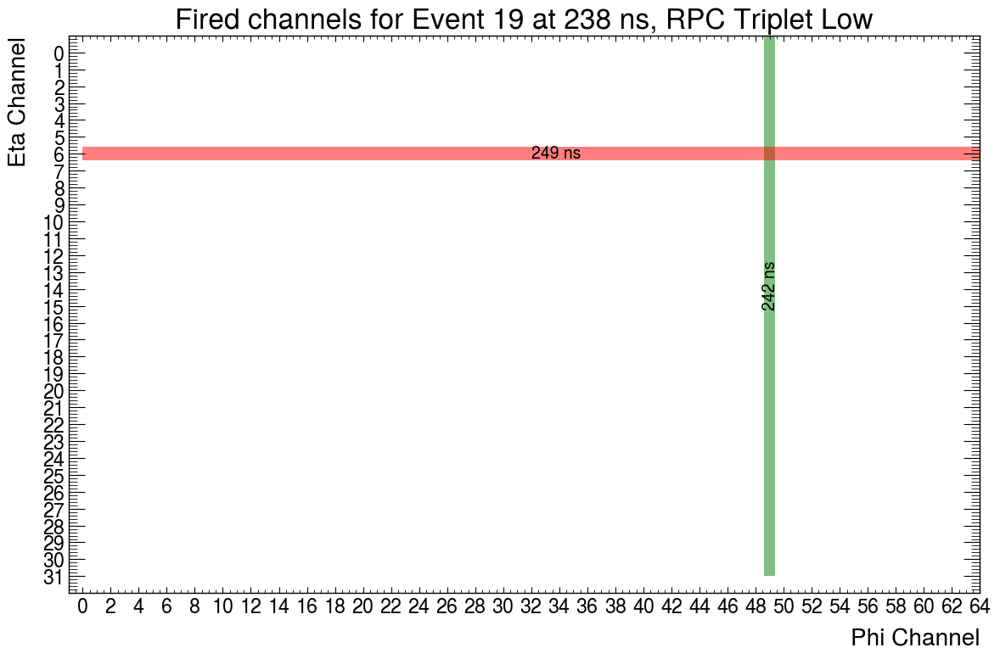

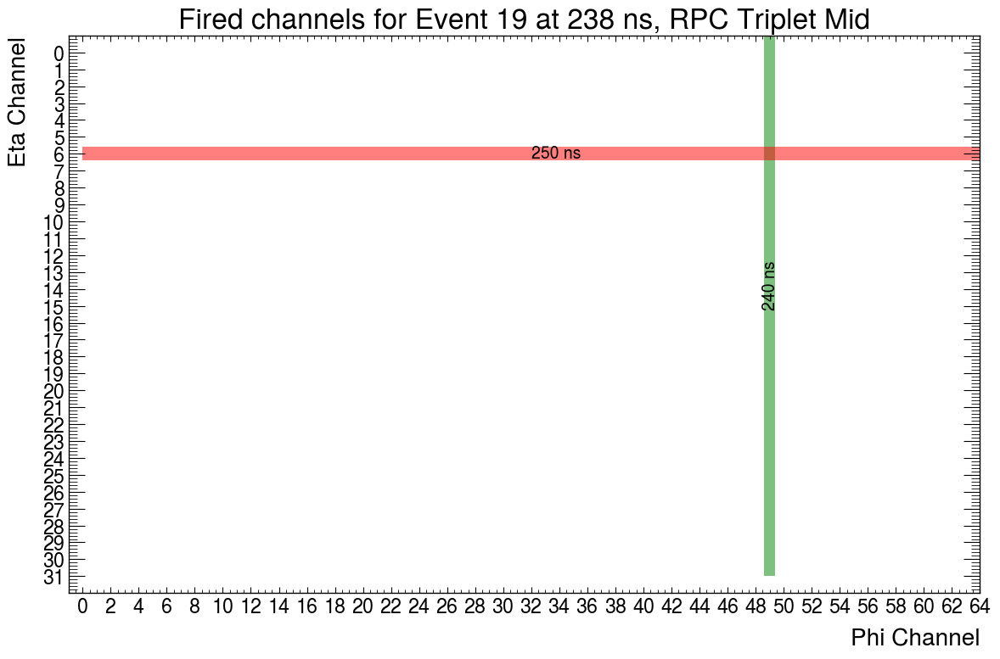

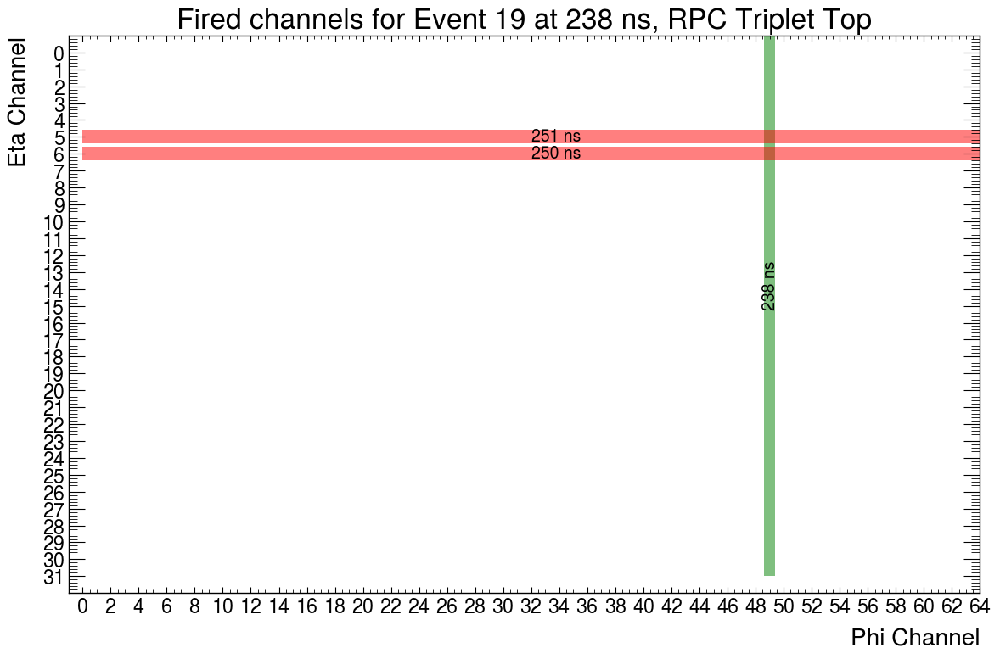

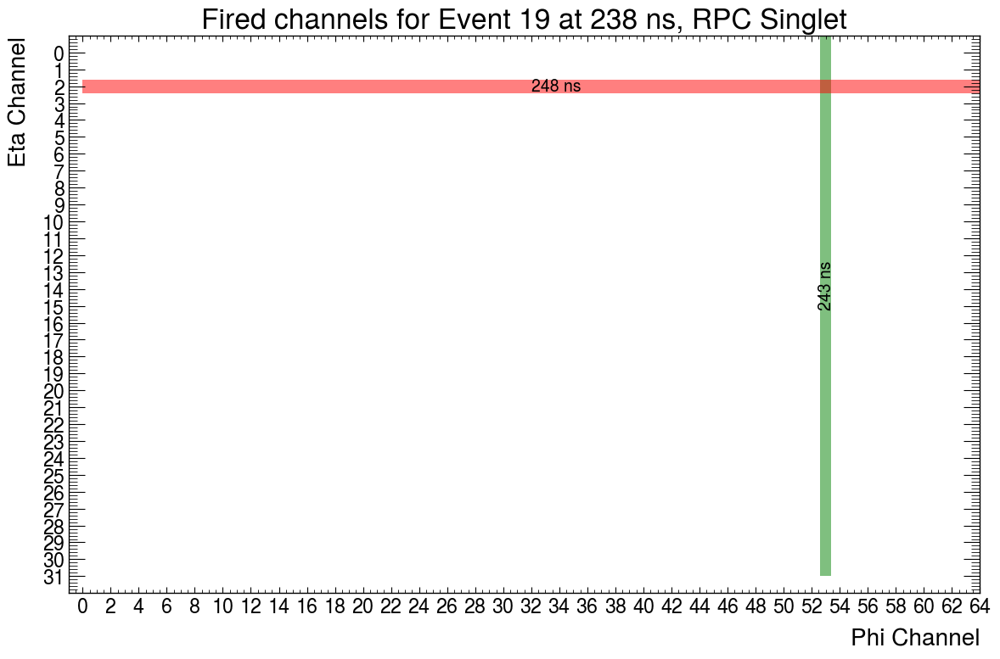

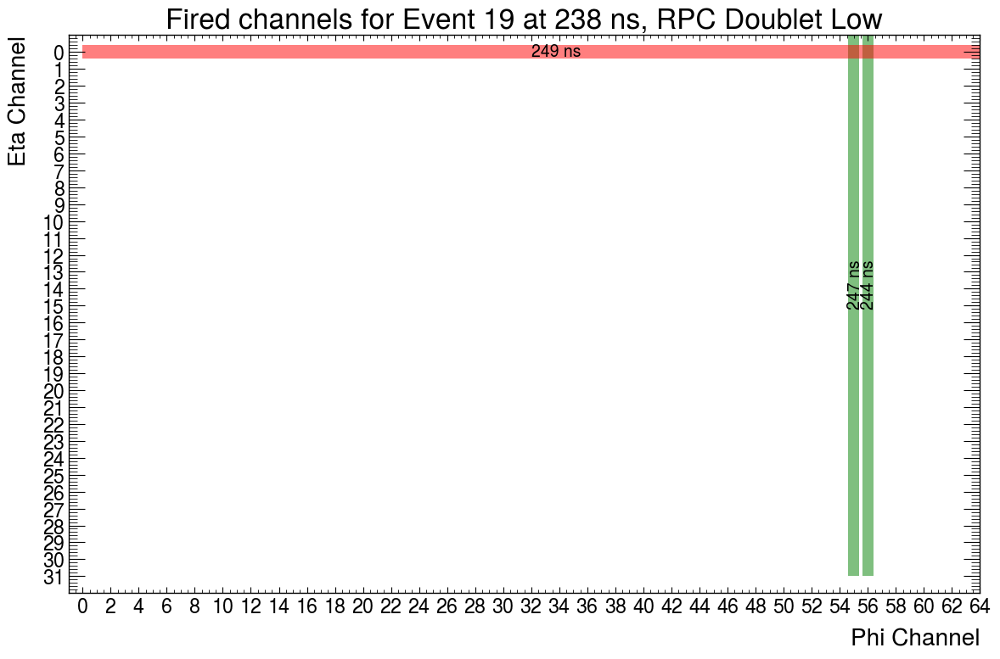

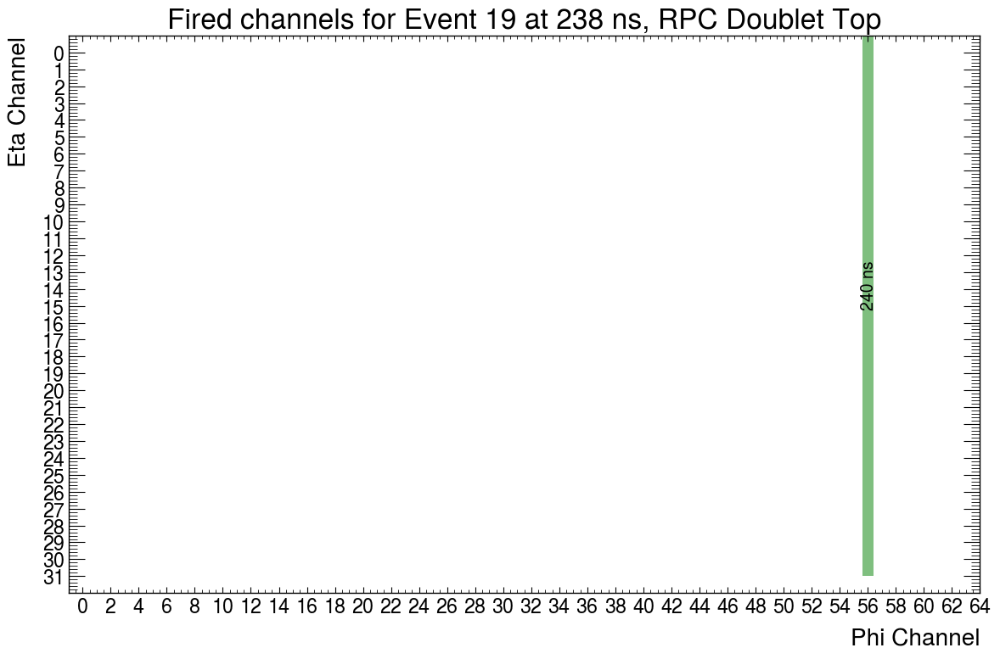

In [130]:
ANT.plot_event_cluster(ANT.convert_cluster_to_plot(exclude_five[1]))

In [158]:
E33_239 = reconstruct_timed_byRPC(exclude_five[3],3,4)

ANT.interactive_muon_plot(E33_239[0],E33_239[1],E33_239[2])

In [153]:
muon_coords = does_muon_hit_RPC(E33_239[0],E33_239[1],4)

Muon does not hit RPC


In [151]:
if E33_239:

    print(muon_coords)
    print(E33_239[6])

    check = does_RPC_detect_muon(muon_coords,E33_239[6],5)


[155.66630784035823, 95.23691158433844]
[[], [], 'N']
No coordinates reconstructed by RPC


The problem seems to be that removing the RPC under test can drastically alter the trajectory of the particle. To overcome this, I will enforce that atleast one RPC goes off in every chamber to ensure that the reconstructed path is accurate still. 

Basically, just making sure that 4 other RPCs are included in the reconstructed coords. This can be done by checking the len(optimised_coords) > 5. 

In [254]:
efficiency_1_redone = calc_efficiency_RPC(coincident_hits_ATLAS_clustered,5,100)

Number of events in filter = 4022
Event index 0
[[[136.74375], [76.1022], 242.0], [[136.74375], [76.1022], 240.0], [[136.74375], [77.59440000000001], 238.0], [[147.79375000000002], [88.0398], 243.0], [[154.70000000000002], [94.0086], 245.5], [[], [], 'N']]
Muon does not hit RPC
Event index 1
[[[81.49375], [43.2738], 239.0], [[82.875], [43.2738], 239.0], [[82.875], [44.766000000000005], 237.0], [[89.78125], [55.2114], 238.0], [[92.54375], [61.18019999999999], 241.66666666666666], [[91.1625], [61.1802], 243.0]]
[[91.1625], [61.1802], 243.0]
[91.1625, 61.1802]
2.6694223797097725
RPC successfully detects hit!
Event index 2
[[[89.78125], [35.812799999999996], 243.0], [[89.78125], [35.812799999999996], 242.0], [[89.78125], [37.305], 239.0], [[], [], 'N'], [[], [], 'N'], [[89.78125, 95.30625, 103.59375], [74.61], 252.33333333333334]]
Event index 3
[[[29.00625], [43.2738], 231.0], [[29.00625], [44.766000000000005], 231.0], [[29.00625], [46.2582], 248.5], [[29.00625], [73.1178], 236.0], [[29.00

In [255]:
print(efficiency_1_redone)

0.40927077444884113


Still quite low, could try relaxing the time window a bit.

In [257]:
events_test = filter_events_by_RPC(coincident_hits_ATLAS_clustered,2,5,5)

Number of events in filter = 4022


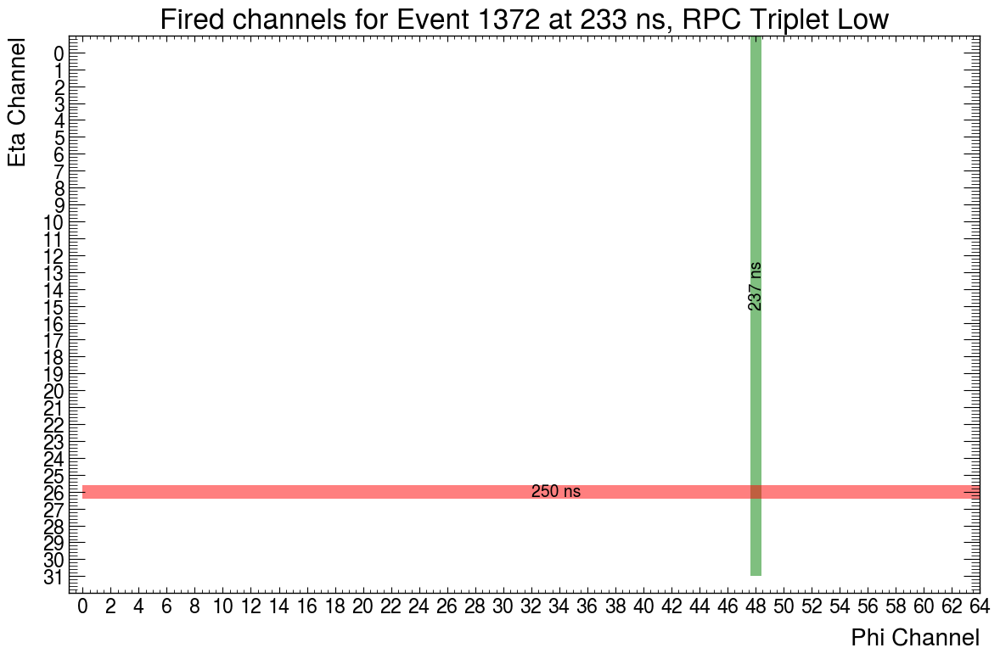

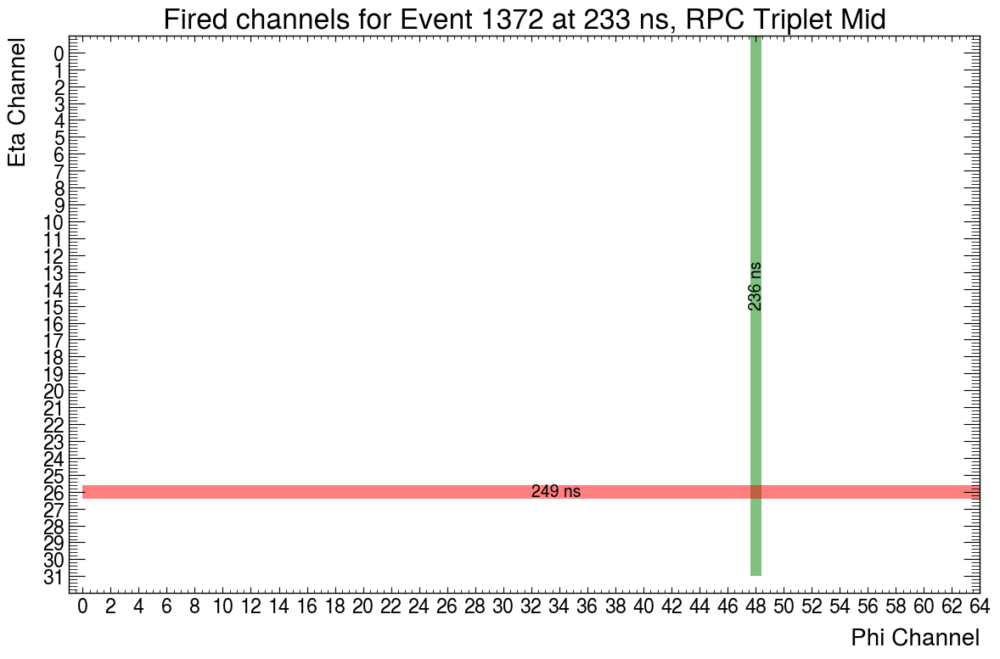

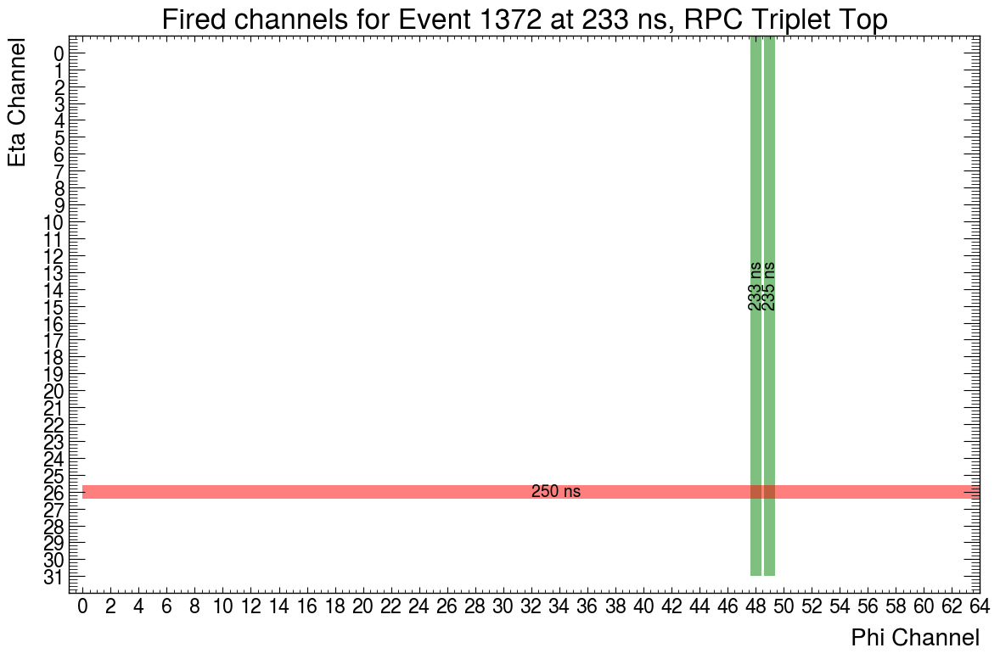

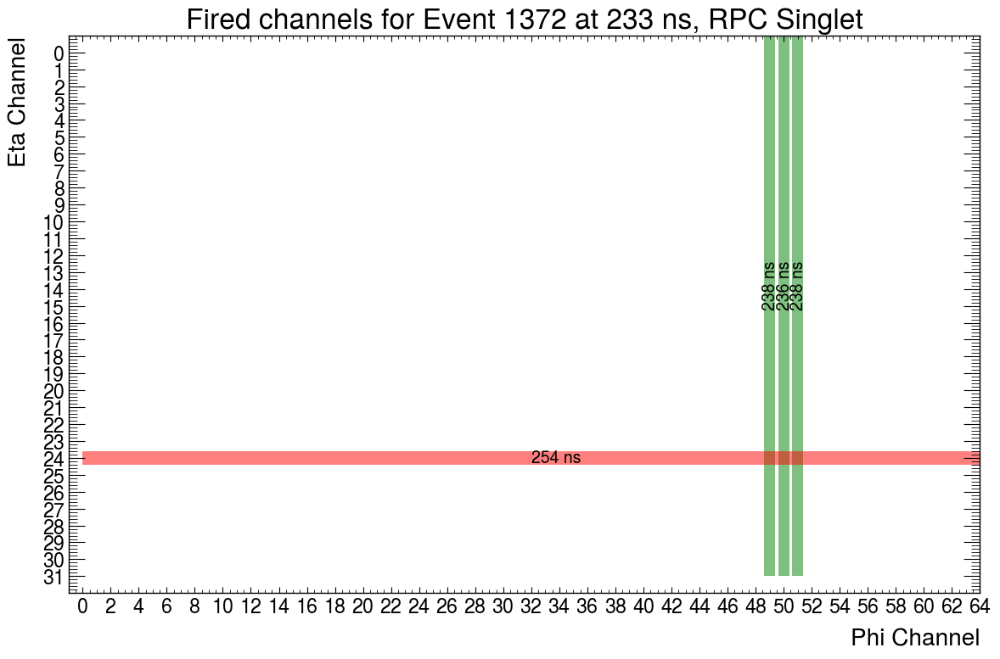

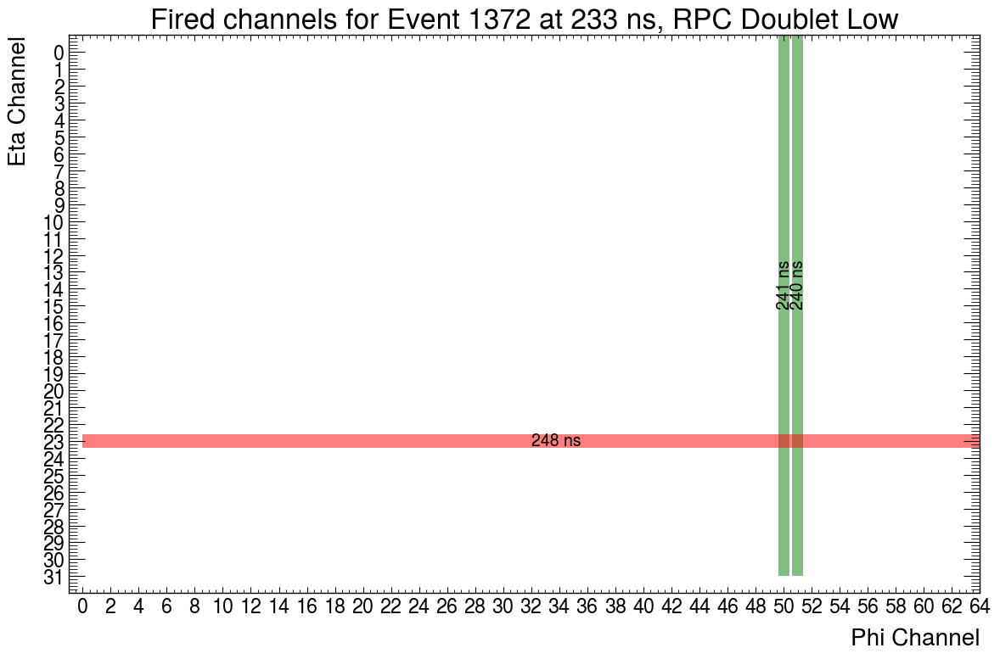

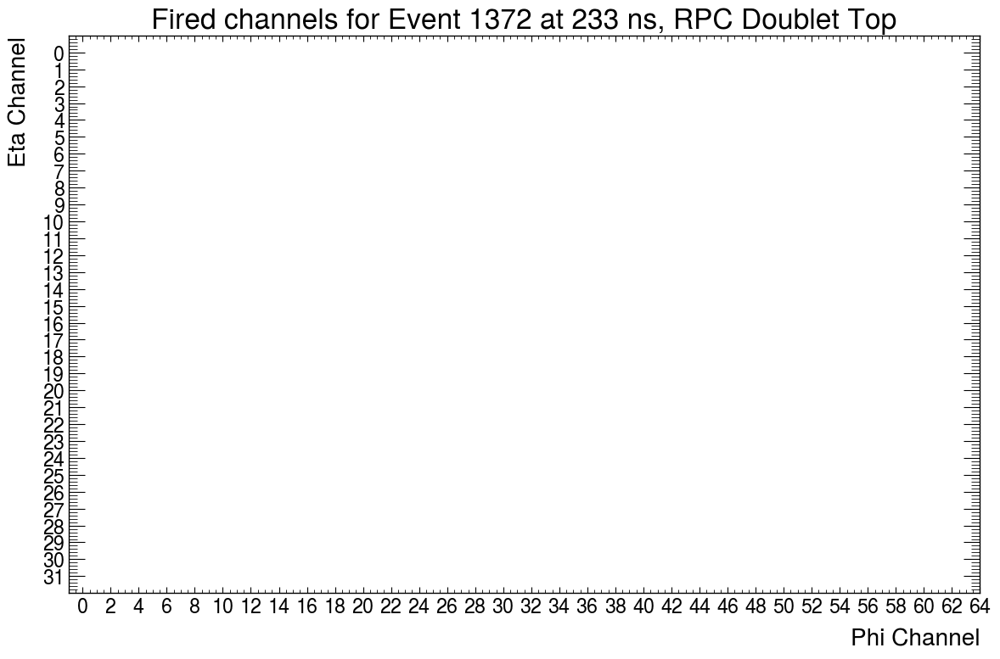

In [287]:
ANT.plot_event_cluster(ANT.convert_cluster_to_plot(events_test[70]))

In [288]:
print(phiHits[5][1372])
print(etaHits[5][1372])

[[], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], []]
[[], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], []]


In [285]:
print(phiHits[5][61])
print(etaHits[5][61])

[[397312, 397361], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], []]
[[], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], []]


^^ This is not good, looks like corrupt data

In [275]:
E33_239 = reconstruct_timed_byRPC(events_test[10],3,5)

if E33_239:
    
    muon_coords = does_muon_hit_RPC(E33_239[0],E33_239[1],5)

    print(muon_coords)
    print(E33_239[6])

    check = does_RPC_detect_muon(muon_coords,E33_239[6],5)

[[[], [], 'N'], [[], [], 'N'], [[], [], 'N'], [[], [], 'N'], [[22.1], [38.797200000000004], 236.5], [[], [], 'N']]
Failed to reconstruct, dT is NoneType


Try relaxing time window to 30 ns

In [261]:
#Time_window for coincidence set at 15 ns.
#Temporal Clustering
coincident_hits_ATLAS_30ns = ANT.FindCoincidentHits(etaHits,phiHits,30)

#Spatial Clustering
coincident_hits_ATLAS_clustered_30ns = ANT.cluster(coincident_hits_ATLAS_30ns)

0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0

In [262]:
efficiency_5_30ns = calc_efficiency_RPC(coincident_hits_ATLAS_clustered_30ns,5,100)

Number of events in filter = 4059
Event index 0
[[[136.74375], [76.1022], 242.0], [[136.74375], [76.1022], 240.0], [[136.74375], [77.59440000000001], 238.0], [[147.79375000000002], [88.0398], 243.0], [[154.70000000000002], [94.0086], 245.5], [[], [], 'N']]
Muon does not hit RPC
Event index 1
[[[81.49375], [43.2738], 239.0], [[82.875], [43.2738], 239.0], [[82.875], [44.766000000000005], 237.0], [[89.78125], [55.2114], 238.0], [[92.54375], [61.18019999999999], 241.66666666666666], [[91.1625], [61.1802], 243.0]]
[[91.1625], [61.1802], 243.0]
[91.1625, 61.1802]
2.6694223797097725
RPC successfully detects hit!
Event index 2
[[[89.78125], [35.812799999999996], 243.0], [[89.78125], [35.812799999999996], 242.0], [[89.78125], [37.305], 239.0], [[], [], 'N'], [[], [], 'N'], [[89.78125, 95.30625, 103.59375], [74.61], 252.33333333333334]]
Event index 3
[[[29.00625], [43.2738], 231.0], [[29.00625], [44.766000000000005], 231.0], [[29.00625], [46.2582], 248.5], [[29.00625], [73.1178], 236.0], [[29.00

In [263]:
print(efficiency_5_30ns)

0.38969310943833235


Noticed bug in phiHits, etaHits. An event should not have time 851851

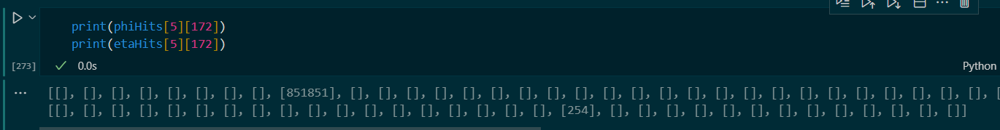

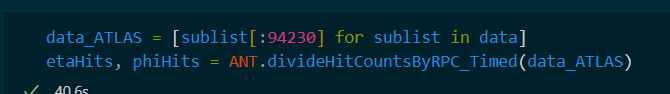

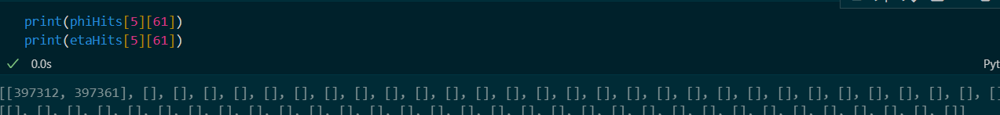

No obvious reason why efficiencies so low. Just seems the RPCs instrinsically have a low efficiency?

Test with cosmic muon data now.

In [289]:
data2 = ANT.importDatafile(current_directory+"\\ProAnubisData\\threeHourRun_24_3_1.h5")

etaHits2, phiHits2 = ANT.divideHitCountsByRPC_Timed(data2)

#ANT.importDatafile is from original scripts. ANT.divideHitCountsByRPC_Timed() is modified from original scripts. All other functions are new.

#Time_window for coincidence set at 15 ns.
#Temporal Clustering
coincident_hits_3hrs_cosmics = ANT.FindCoincidentHits(etaHits2,phiHits2,15)

#Spatial Clustering
coincident_hits_3hrs_clustered = ANT.cluster(coincident_hits_3hrs_cosmics)

0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0

In [303]:
efficiency_1_cosmics = calc_efficiency_RPC(coincident_hits_3hrs_clustered,3,5)

Number of events in filter = 3150
Event index 0
[[[], [], 'N'], [[114.64375000000001], [7.461], 229.0], [[114.64375000000001], [7.461], 227.0], [[99.45000000000002], [22.383], 227.0], [[88.4], [34.3206], 224.5], [[87.01875000000001], [35.812799999999996], 229.0]]
Event index 1
[[[37.29375], [43.2738], 256.0], [[38.675000000000004], [41.7816], 254.5], [[38.675000000000004], [43.2738], 254.0], [[46.962500000000006], [55.2114], 252.5], [[], [], 'N'], [[52.487500000000004], [64.1646], 250.5]]
Event index 2
[[[59.393750000000004], [73.1178], 255.0], [[60.775000000000006], [73.1178], 254.5], [[60.775000000000006], [74.61], 255.5], [[106.35625, 116.025], [82.071], 253.0], [[140.88750000000002], [88.0398], 248.5], [[142.26875], [88.0398], 246.0]]
[[106.35625, 116.025], [82.071], 253.0]
[106.35625, 82.071]
5.75568169267637
[116.025, 82.071]
15.334021722251835
No RPC coordinates constructed pass near the expected point!
Event index 3
[[[88.4], [37.305], 251.5], [[88.4], [37.305], 251.0], [[88.4]

In [304]:
print(efficiency_1_cosmics)

0.6335174953959485


In [305]:
events_test_cosmics = filter_events_by_RPC(coincident_hits_3hrs_clustered,2,5,3)

Number of events in filter = 3150


In [307]:
E33_239 = reconstruct_timed_byRPC(events_test_cosmics[3],3,3)

if E33_239:
    
    muon_coords = does_muon_hit_RPC(E33_239[0],E33_239[1],3)

    print(muon_coords)
    print(E33_239[6])

    check = does_RPC_detect_muon(muon_coords,E33_239[6],5)

[[[88.4], [37.305], 251.5], [[88.4], [37.305], 251.0], [[88.4], [37.305], 249.5], [[], [], 'N'], [[78.73125], [92.5164], 247.0], [[78.73125], [92.5164], 248.0]]
[83.58983652038202, 64.77244511323384]
[[], [], 'N']
[[], [], 'N']
No coordinates reconstructed by RPC


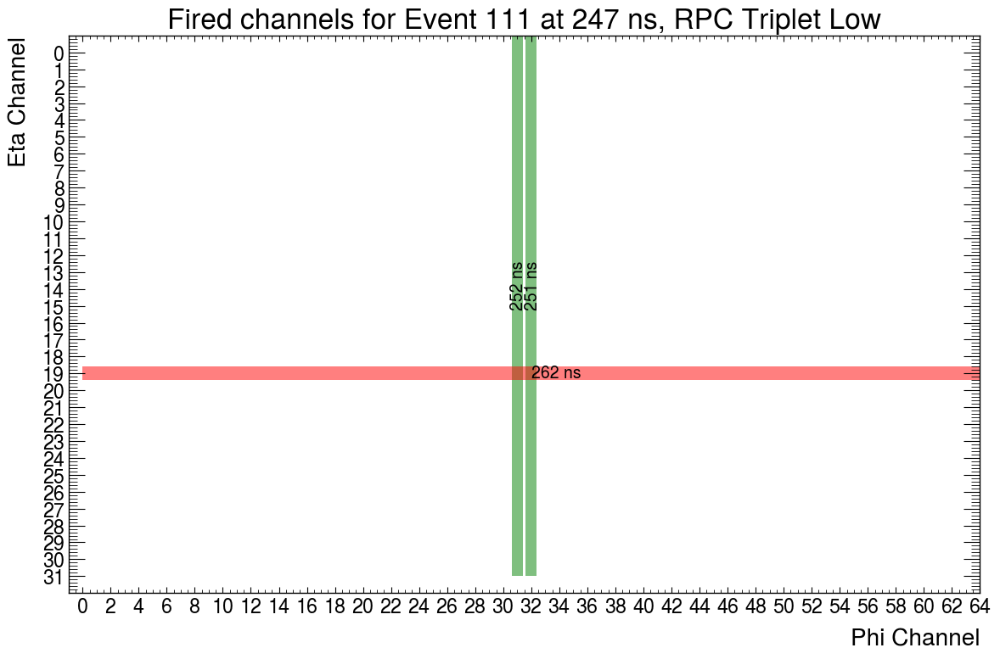

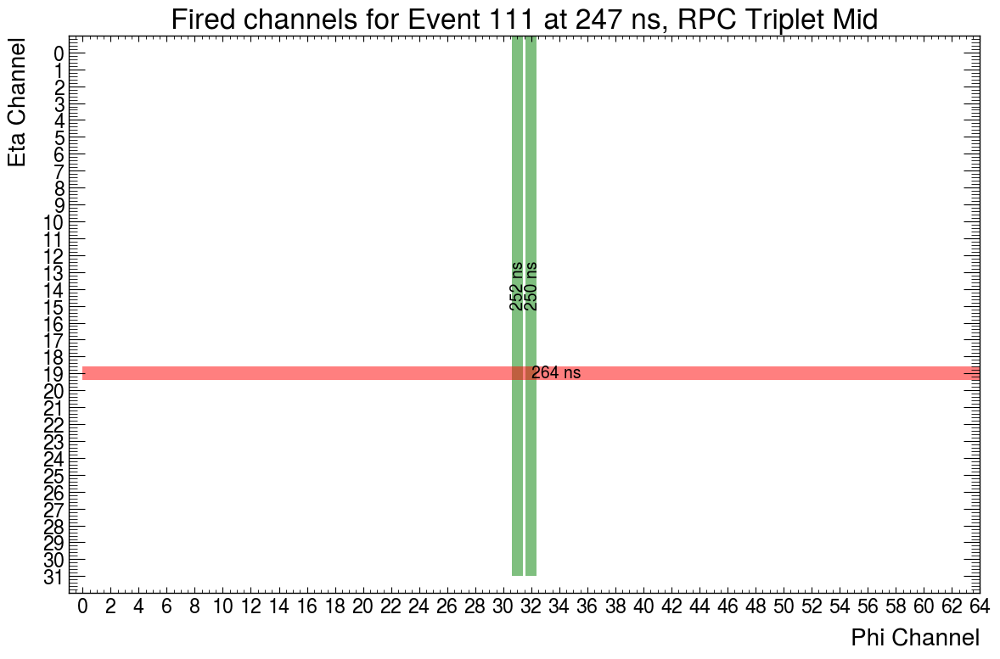

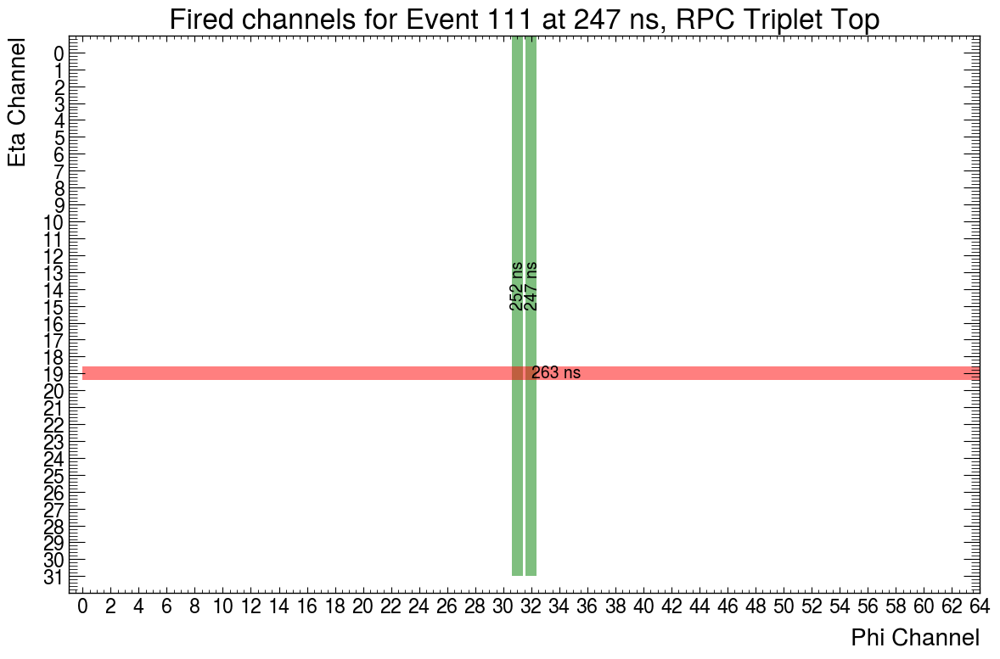

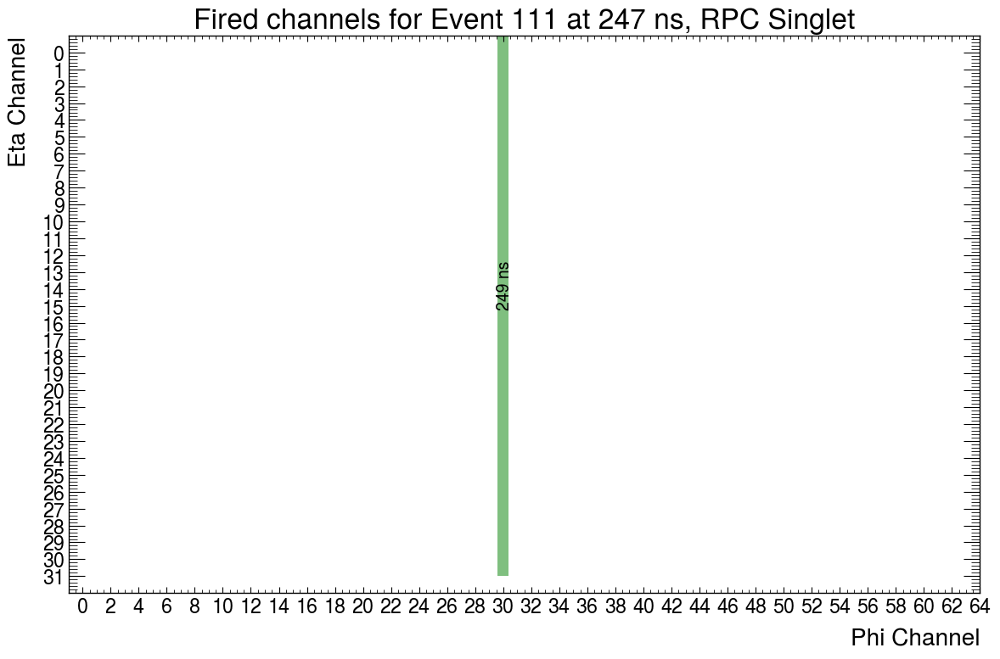

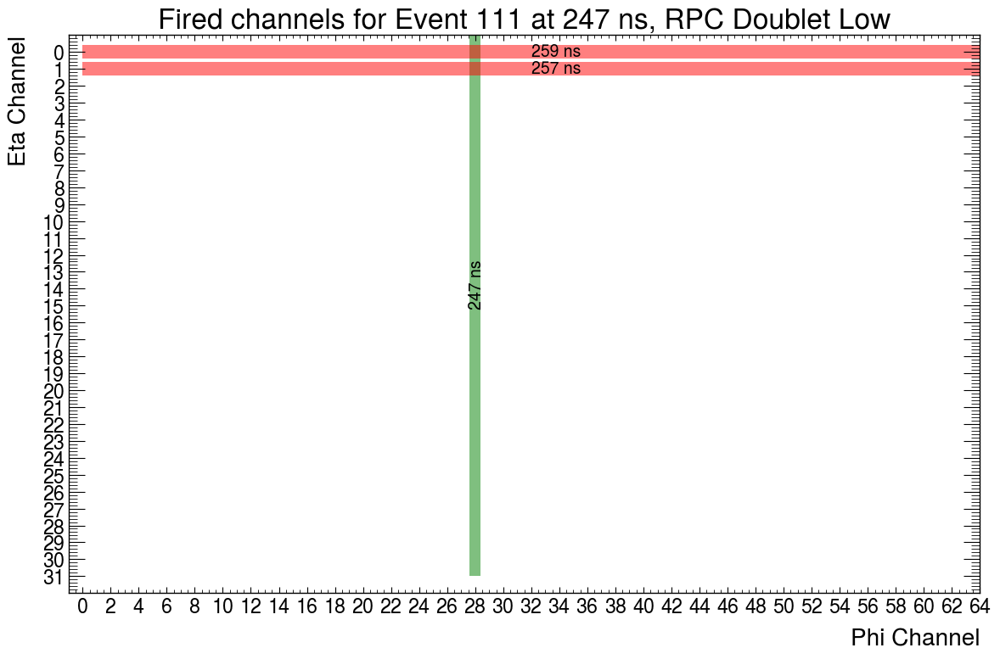

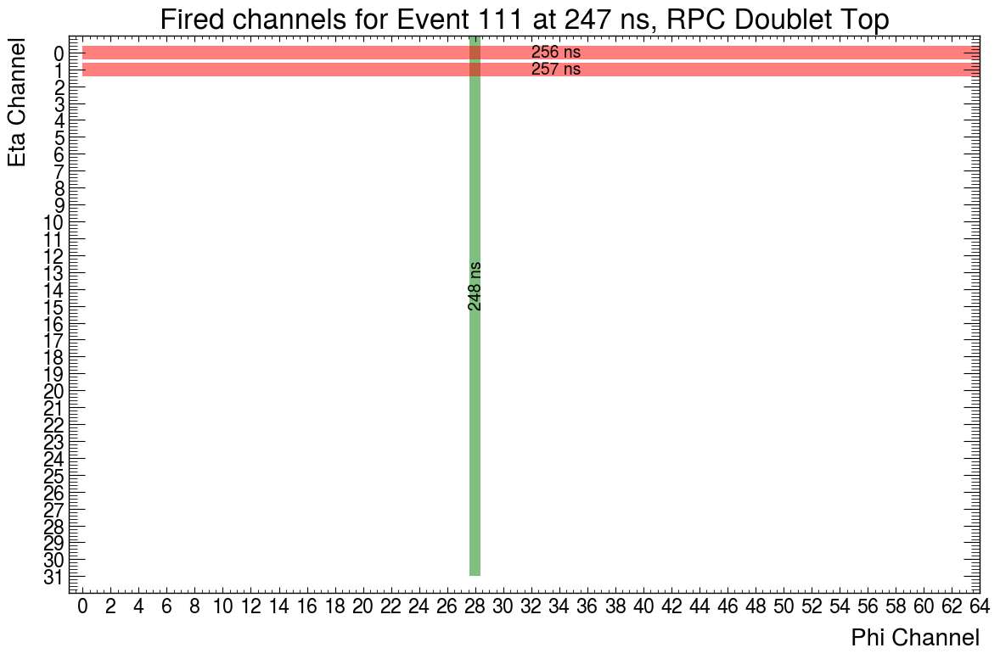

In [306]:
ANT.plot_event_cluster(ANT.convert_cluster_to_plot(events_test_cosmics[3]))

I'm going to modify the code, now instead of checking for eta AND phi, it checks eta separetly and phi separately. 

In [331]:
def extract_coords_timed_eta_phi(event,max_cluster_size):

    #This function converts spatially clusters in RPCs into x and y coordinates (z given by RPC number)
    # event = ['Event x',TIMEBIN, [[[RPC1_PHI_CLUSTERS],[RPC1_ETA_CLUSTERS]],[[...],[...]],...]

    #Extract x and y coords of cluster in event
    distance_per_phi_channel = 2.7625 #cm
    distance_per_eta_channel = 2.9844 #cm
    
    coords = []

    for RPC in range(6):
        
        x_clusters = [x for x in event[2][RPC][0] if len(x)<=max_cluster_size] #phi direction
        y_clusters = [y for y in event[2][RPC][1] if len(y)<=max_cluster_size] #eta direction

        #Finding size of largest cluster, consider coordinates bad if largest cluster is larger than 6.
        x_clusters_lengths = [len(x) for x in event[2][RPC][0]]
        y_clusters_lengths = [len(y) for y in event[2][RPC][1]]

        max_length = max(max(x_clusters_lengths, default=0), max(y_clusters_lengths, default=0))

        avg_time = 0

        x_coords = []
        y_coords = []

        for x_cluster in x_clusters:
           #x_cluster = [[RPC,CHANNEL,TIME,'phi'],...]
            phi_channels = [x[1] for x in x_cluster]
            phi_times = [t[2] for t in x_cluster]

            if phi_channels:
                avg_time = np.average(phi_times)

            #Convert the channel number into a measurement along the RPC.
            x_values = [(phi_channel+0.5)*distance_per_phi_channel for phi_channel in phi_channels]
            x_coords.append(np.mean(x_values))
            #x_error

        for y_cluster in y_clusters:
            #y_cluster = [[RPC,CHANNEL,TIME,'eta'],...]
            eta_channels_corrected = [31-y[1] for y in y_cluster] #corrected for labelling from 0 to 31.
            y_values = [(channel_num+0.5)*distance_per_eta_channel for channel_num in eta_channels_corrected]
            y_coords.append(np.mean(y_values))

            if avg_time == 0:
                eta_times = [t[2] for t in y_cluster]
                #If phi not used for avg_time, eta used instead.
                avg_time = np.average(eta_times)

            #x_error

        if not x_coords and not y_coords:
            coords.append([[],[],"N"])
        elif max_length<6:
            coords.append([x_coords, y_coords,avg_time])
        else:
            coords.append([[],[],"N"])
    
    #RPC_coords = [x_coords,y_coords,avg_time on phi side hits]

    #coords = [[RPC1_coords],[RPC2_coords],[RPC3_coords],...]
    return(coords)

In [319]:
def does_RPC_detect_muon_eta_phi(muon_coords,test_coords,tol):
    #Tolerance in units of cm. 

    etaHit = False
    phiHit = False

    if test_coords != [[],[],"N"]: 

        t = test_coords[:-1]# Doing this because .pop() seems to act globally...

        for x in t[0]:
            print(x)
             
            offset_x = np.abs(x - muon_coords[0])

            if offset_x < tol:
                phiHit = True
    
        for y in t[1]:
            print(y)

            offset_y = np.abs(y - muon_coords[1])

            if offset_y < tol:
                 etaHit = True
        
        if etaHit:
            if phiHit:
                #Phi and eta
                return 3
            else:
                #Eta only
                return 2
        elif phiHit:
                #Phi only
                return 1
        else:
             #Neither
             return 0
        
    else:
        print("No coordinates reconstructed by RPC")
        return False


In [311]:
def calc_efficiency_RPC_eta_phi(dataset,RPC,tol):
    # RPC input is number 0 to 5.
    # dataset is output of ANT.cluser()
    # tol is tolerance on checkHit in cm.

    events = filter_events_by_RPC(dataset,2,5,RPC)

    possible_reconstructions = 0
    successful_reconstructions_eta = 0
    successful_reconstructions_phi = 0

    for i,event in enumerate(events):

        print(f"Event index {i}")

        E_recon = reconstruct_timed_byRPC(event,3,RPC)

        if E_recon:

            if len(E_recon[2])>=5:
                #Adding this check to see if other 5 RPCs are in reconstructed event.
                #This is necessary to ensure the reconstructed path is accurate.

                muon_coords = does_muon_hit_RPC(E_recon[0],E_recon[1],RPC)

                if muon_coords:

                    possible_reconstructions+=1 

                    check = does_RPC_detect_muon_eta_phi(muon_coords,E_recon[6],tol)

                    if check == 3:
                        successful_reconstructions_eta +=1
                        successful_reconstructions_phi +=1
                    elif check ==2:
                        #eta only
                        successful_reconstructions_eta +=1
                    elif check == 1:
                        #phi only
                        successful_reconstructions_phi +=1
    
    print(possible_reconstructions)
    print(successful_reconstructions_eta)
    print(successful_reconstructions_phi)

    efficiency_phi = successful_reconstructions_phi / possible_reconstructions
    efficency_eta = successful_reconstructions_eta / possible_reconstructions

    return efficiency_phi, efficency_eta

Test

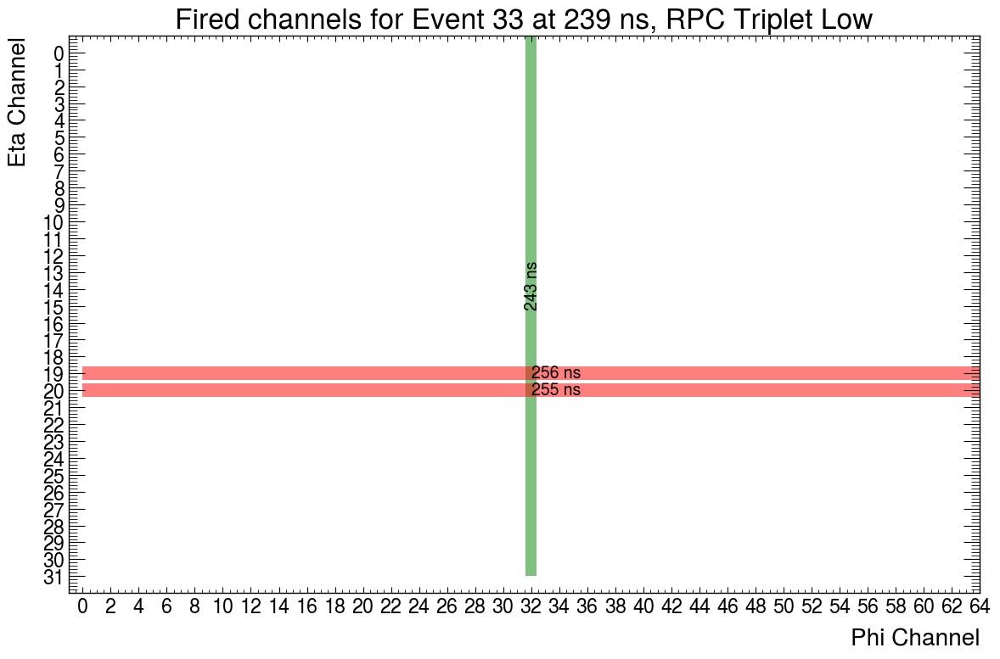

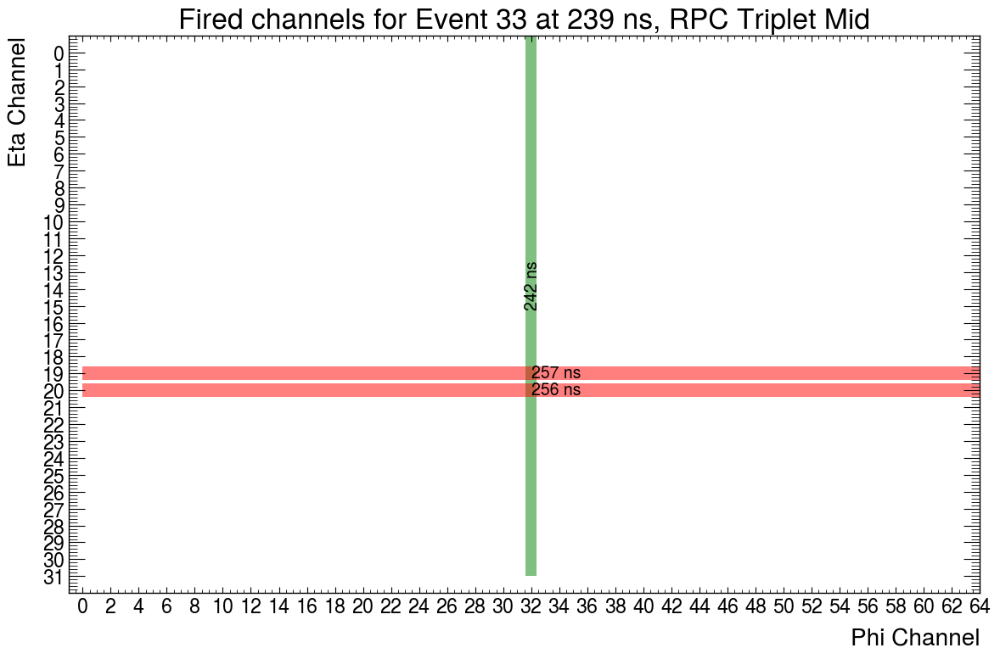

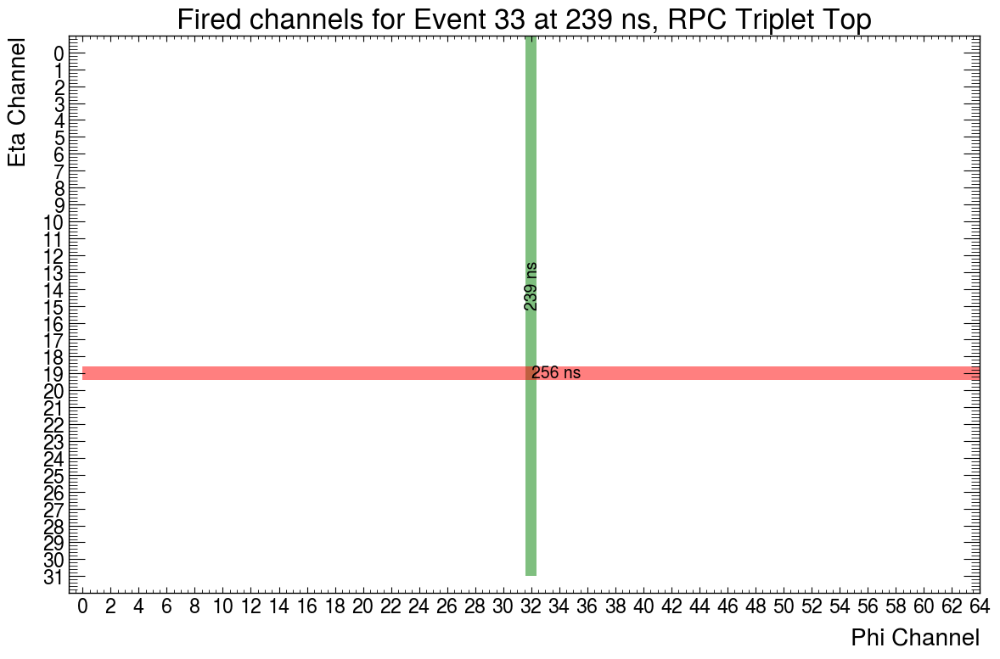

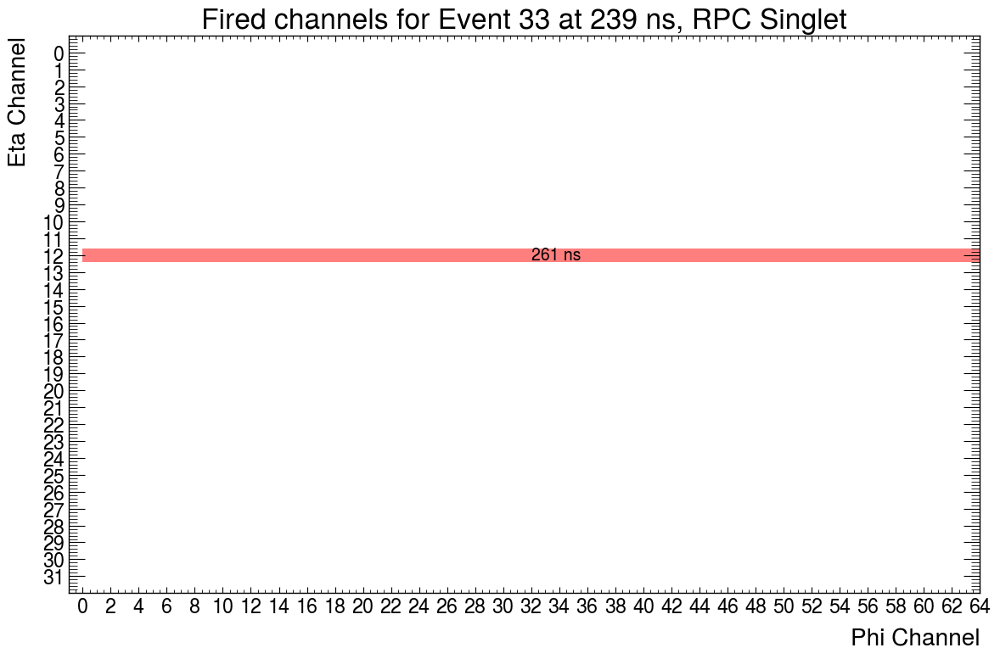

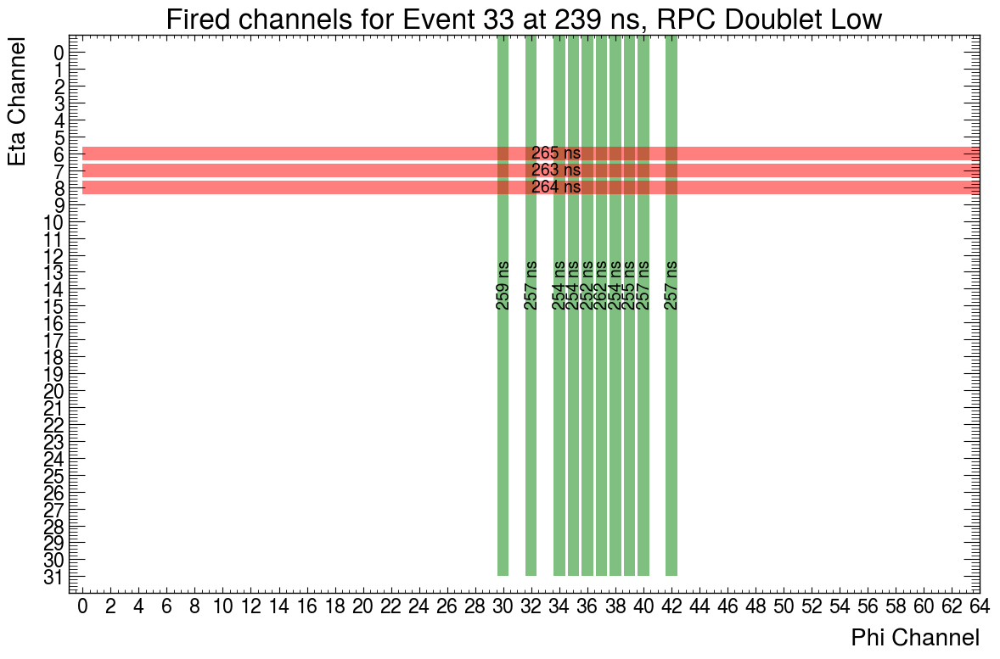

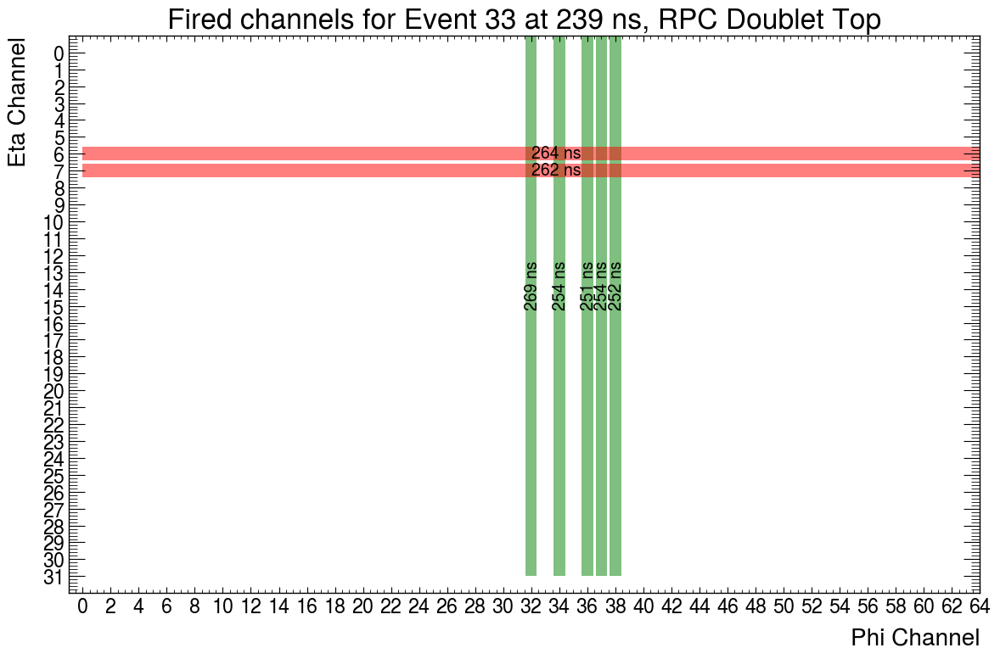

In [317]:
ANT.plot_event_cluster(ANT.convert_cluster_to_plot(exclude_five[3]))

In [326]:
exclude_five = filter_events_by_RPC(coincident_hits_ATLAS_clustered,2,4,5)

E33_239 = reconstruct_timed_byRPC(exclude_five[3],3,3)

if E33_239:
    muon_coords = does_muon_hit_RPC(E33_239[0],E33_239[1],3)

    print(muon_coords)
    print(E33_239[6])

    check = does_RPC_detect_muon_eta_phi(muon_coords,E33_239[6],5)

    print(check)

ANT.interactive_muon_plot(E33_239[0],E33_239[1],E33_239[2])

Number of events in filter = 18475
[[[89.78125], [35.812799999999996], 243.0], [[89.78125], [35.812799999999996], 242.0], [[89.78125], [37.305], 239.0], [[], [58.1958], 239.0], [[89.78125, 95.30625, 103.59375], [74.61], 252.33333333333334]]
[89.78125, 55.46303073341332]
[[], [58.1958], 239.0]
58.1958
2


In [ ]:
def reconstruct_timed_byRPC(event,max_cluster_size,RPC_excluded):

    #timed tag indicates that timing information from RPC is used to determine direction of vertical transversal of "particle" in the event.

    max_residual = 100

    # event = ['Event x',TIMEBIN, [[[RPC1_PHI_CLUSTERS],[RPC1_ETA_CLUSTERS]],[[...],[...]],...]
    RPC_heights = [0.6,1.8,3.0,61.8,121.8,123] #Heights of middle point of each RPC, measured from the bottom of the Triplet Low RPC. Units are cm.

    #Extract x and y coords of cluster in event

    coords = extract_coords_timed_eta_phi(event,max_cluster_size)
    print(coords)

    #UPDATE COORDS TO IGNORE THE RPC UNDER TEST

    test_coords = coords[RPC_excluded]
    coords[RPC_excluded] = [[],[],"N"]

    dT = ANT.extract_DT(coords)

    #print(coords)

    if dT is None:
        print("Failed to reconstruct, dT is NoneType")
        return None

    # Count the number of empty RPCs
    empty_RPC_count = sum(1 for item in coords if item == [[], [],'N'])

    # If less than 3 elements of coords are occupied, exit the function
    if empty_RPC_count > 3:
        print("Failed to reconstruct, not enough coords")
        return None  # Exit the function

    #ITERATING OVER EVERY POSSIBLE COMBINATION OF x,y,z over all 3 RPCs (limited to one x,y per RPC).
    #Doesn't look particularly nice, but there are not many coordinates to loop over usually....

    combinations = ANT.generate_hit_coords_combo(coords,RPC_heights)

    #Now for each combo in combinations, attempt to reconstruct a path. See which one gives the best trajectory.

    #If success, print parameters of fitting function.
    #If fail, print reconstruction failed.

    residuals_current = np.inf
    optimised_coords = None
    optimised_d= None
    optimised_centroid= None

    for ind,combo in enumerate(combinations):

        centroid, d, residuals = ANT.fit_event(combo)
        if residuals < residuals_current:

            # If new fit is better than old then replace old fit.
            residuals_current = residuals
            optimised_centroid = centroid
            optimised_d = d
            optimised_coords = combinations[ind]

    #if dT>0 this implies the particles hit the higher RPC after the lower one, so the particle is travelling upwards here.
    #Vice-versa for dT < 0.

    #dT = 0 case?
    
    if dT > 0:
        if optimised_d[2] < 0:
            optimised_d = np.multiply(optimised_d,-1)
    else:
        if optimised_d[2] > 0:
            optimised_d = np.multiply(optimised_d,-1)

    if residuals_current<max_residual:
        return optimised_centroid, optimised_d, optimised_coords, combinations, residuals_current, dT, test_coords
    else:
        print("Failed to reconstruct, residuals too large")
        #return optimised_centroid, optimised_d, optimised_coords, combinations, residuals_current
        return None

In [332]:
efficiency_5_eta_phi = calc_efficiency_RPC_eta_phi(coincident_hits_ATLAS_clustered,5,5)

Number of events in filter = 4022
Event index 0
[[[136.74375], [76.1022], 242.0], [[136.74375], [76.1022], 240.0], [[136.74375], [77.59440000000001], 238.0], [[147.79375000000002], [88.0398], 243.0], [[154.70000000000002], [94.0086], 245.5], [[156.08125], [], 240.0]]
Muon does not hit RPC
Event index 1
[[[81.49375], [43.2738], 239.0], [[82.875], [43.2738], 239.0], [[82.875], [44.766000000000005], 237.0], [[89.78125], [55.2114], 238.0], [[92.54375], [61.18019999999999], 241.66666666666666], [[91.1625], [61.1802], 243.0]]
91.1625
61.1802
Event index 2
[[[89.78125], [35.812799999999996], 243.0], [[89.78125], [35.812799999999996], 242.0], [[89.78125], [37.305], 239.0], [[], [58.1958], 261.0], [[], [], 'N'], [[89.78125, 95.30625, 103.59375], [74.61], 252.33333333333334]]
Event index 3
[[[29.00625], [43.2738], 231.0], [[29.00625], [44.766000000000005], 231.0], [[29.00625], [46.2582], 248.5], [[29.00625], [73.1178], 236.0], [[29.00625], [91.0242], 242.0], [[], [92.5164], 256.5]]
92.5164
Event

c:\Users\patri\AppData\Local\Programs\Python\Python310\lib\site-packages\numpy\core\fromnumeric.py:3504: RuntimeWarning:

Mean of empty slice.

c:\Users\patri\AppData\Local\Programs\Python\Python310\lib\site-packages\numpy\core\_methods.py:129: RuntimeWarning:

invalid value encountered in scalar divide



LinAlgError: 1-dimensional array given. Array must be at least two-dimensional

THIS IS A MESS TO UNTANGLE! AND I HAVE MINOR EXAMS TO REVISE FOR FFS!